# Visualisation of inference results
Test years: 2018-2022 (included)

# I. Mean MOS 

## 1. Maps 

### Utils

In [4]:
import numpy as np 
import matplotlib.pyplot as plt
import xarray as xr
import pandas as pd
import cartopy.crs as ccrs

In [5]:
def plot_map(lats, lons, data, name, cmap='viridis'):
    plt.figure(figsize=(20, 5))
    buffer = 0.01
    ax = plt.axes(projection=ccrs.PlateCarree())
    # Calculate extent with buffer to avoid identical limits
    lon_min, lon_max = lons.min(), lons.max()
    lat_min, lat_max = lats.min(), lats.max()
    # extent = [lon_min, lon_max, lat_min - buffer, lat_max + buffer]
    
    # ax.set_extent(extent, crs=ccrs.PlateCarree())
    ax.coastlines()
    
    # Plot data
    im = ax.imshow(data, origin='lower', extent=[lon_min, lon_max+1.5, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap=cmap)
    plt.colorbar(im, label=name, extend='both')
    ax.gridlines(draw_labels=True)
    plt.show()
    

### Visualize CRPS

In [3]:
def plot_crps_var(variable, lead, projection=ccrs.PlateCarree()):
    index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
    base_dir = f"training_results/spatial_month/lead{lead}"
    if variable == "2m_temperature":
        train_index = 1
        epoch = 9
    else:
        train_index = 2
        epoch = 14

    # Determine the min and max CRPS values
    min_crps, max_crps = float('inf'), -float('inf')
    for month in range(1, 13):
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        train_index += 2
        eval_data = xr.open_dataset(file_path)

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]
        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        
        min_crps = min(min_crps, crps.min())
        max_crps = max(max_crps, crps.max())

    # normalize accross all months
    # TODO : adapt normalization to the data
    norm = plt.Normalize(vmin=min_crps, vmax=max_crps)

    # second loop to plot
    if variable == "2m_temperature":
        train_index = 1
    else:
        train_index = 2

    fig, axes = plt.subplots(4, 3, figsize=(20, 15), subplot_kw={'projection': projection})
    fig.suptitle(f"CRPS for {variable}")
    for month in range(1,13):
        # get month data 
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        train_index += 2
        print(file_path)
        eval_data = xr.open_dataset(file_path)
        lats = eval_data.latitude.values
        lons = eval_data.longitude.values
        lon_min, lon_max = lons.min(), lons.max()
        lat_min, lat_max = lats.min(), lats.max()

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]
        crps = eval_data[f"crps_{name_var}"].mean(axis=0)

        # plot 
        ax = axes[(month-1)//3, (month-1)%3]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.coastlines()
        im = ax.imshow(crps, origin='lower', extent=[lon_min, lon_max, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap='viridis', norm=norm)
        ax.set_title(f"{index2month[month]}")

    # Add a colorbar that spans all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    fig.colorbar(im, cax=cbar_ax, label="CRPS", extend='both', norm=norm)
    plt.show()



training_results/spatial_month/lead28/training_1_spatial_month1_2m_temperature_lead=28/crps_9.nc


training_results/spatial_month/lead28/training_3_spatial_month2_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_5_spatial_month3_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_7_spatial_month4_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_9_spatial_month5_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_11_spatial_month6_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_13_spatial_month7_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_15_spatial_month8_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_17_spatial_month9_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_19_spatial_month10_2m_temperature_lead=28/crps_9.nc
training_results/spatial_month/lead28/training_21_spatial_month11_2m_temperature_lead=28/crps_9.nc
training_results/spati

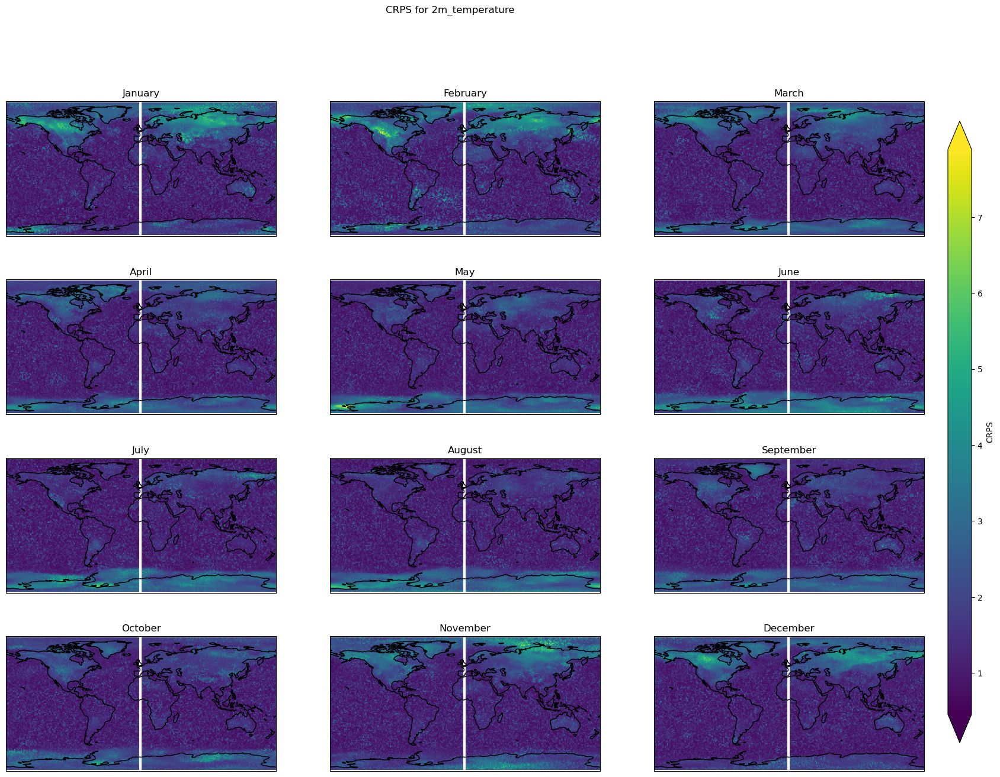

In [6]:
plot_crps_var("2m_temperature", 28)

training_results/spatial_month/lead28/training_2_spatial_month1_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_4_spatial_month2_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_6_spatial_month3_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_8_spatial_month4_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_10_spatial_month5_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_12_spatial_month6_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_14_spatial_month7_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_16_spatial_month8_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_18_spatial_month9_10m_wind_speed_lead=28/crps_14.nc
training_results/spatial_month/lead28/training_20_spatial_month10_10m_wind_speed_lead=28/crps_14.nc
training_resu

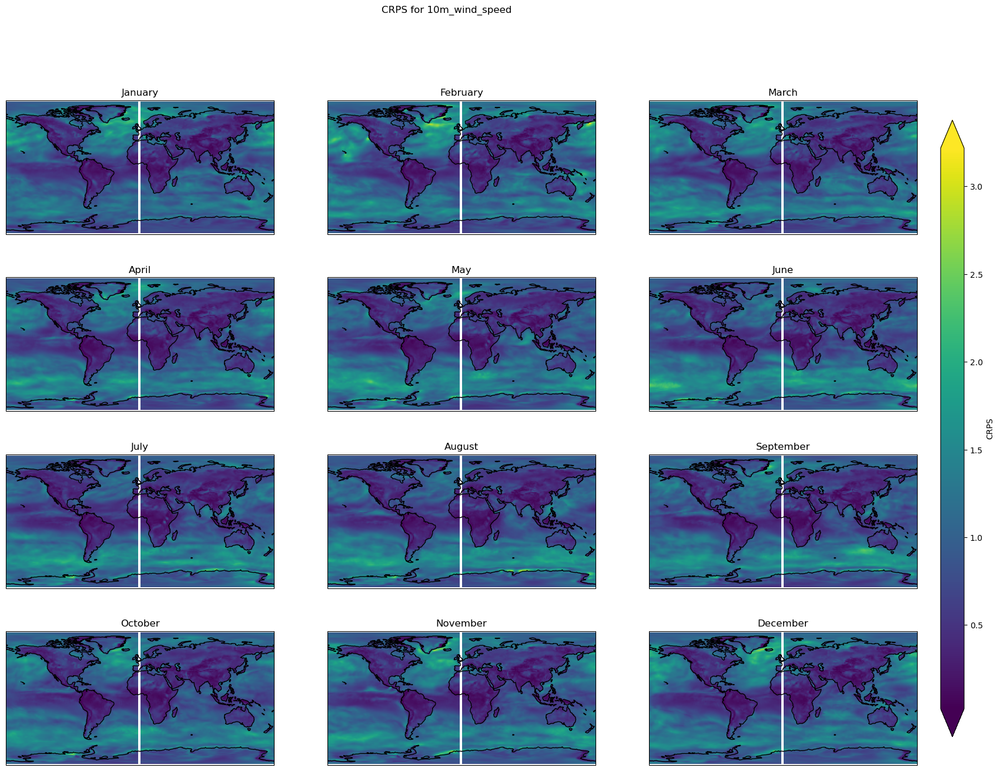

In [7]:
plot_crps_var("10m_wind_speed",28)

### Visualize CRPSS

In [6]:
def compute_crpss(crps, crps_clim):
    return 1 - crps / crps_clim

def plot_crpss_var(variable, lead, projection=ccrs.PlateCarree()):
    index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
    base_dir = f"training_results/spatial_month/lead{lead}"
    if variable == "2m_temperature":
        train_index = 1
        epoch = 9
    else:
        train_index = 2
        epoch = 14

    # Determine the min and max CRPS values
    min_crpss, max_crpss = float('inf'), -float('inf')
    for month in range(1, 13):
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        train_index += 2
        eval_data = xr.open_dataset(file_path)

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]

        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)
        crpss = compute_crpss(crps, crps_clim)
        
        min_crpss= min(min_crpss, crpss.min())
        max_crpss = max(max_crpss, crpss.max())

    # normalize accross all months
    # TODO : adapt normalization to the data
    norm = plt.Normalize(vmin=-1, vmax=1)
    print(min_crpss, max_crpss)

    # second loop to plot
    fig, axes = plt.subplots(4, 3, figsize=(20, 15), subplot_kw={'projection': projection})
    fig.suptitle(f"CRPSS for {variable}, lead {lead}")
    for month in range(1,13):
        # get month data 
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        train_index += 2
        #print(file_path)
        eval_data = xr.open_dataset(file_path)
        lats = eval_data.latitude.values
        lons = eval_data.longitude.values
        lon_min, lon_max = lons.min(), lons.max()
        lat_min, lat_max = lats.min(), lats.max()

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]
        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)
        crpss = compute_crpss(crps, crps_clim)
        #print("Month:", crpss.mean(), crpss.max(), crpss.min())
        mask = crpss > 0

        # plot 
        ax = axes[(month-1)//3, (month-1)%3]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.coastlines()
        im = ax.imshow(crpss, origin='lower', extent=[lon_min, lon_max, lat_min, lat_max], transform=ccrs.PlateCarree(), norm=norm)
        ax.set_title(f"{index2month[month]}")

    # Add a colorbar that spans all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    fig.colorbar(im, cax=cbar_ax, label=f"CRPSS", extend='both', norm=norm)
    plt.show()

def plot_crpss_var_model(variable, lead, exp_name, crpss_type, projection=ccrs.PlateCarree()):
    index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
    base_dir = f"training_results/{exp_name}/lead{lead}"
    base_dir_raw = f"/home/majanvie/scratch/data/test/EMOS/crps/lead{lead}"
    if variable == "2m_temperature":
        train_index = 1
        epoch = 9
    else:
        train_index = 2
        epoch = 14

    # Determine the min and max CRPS values
    min_crpss, max_crpss = float('inf'), -float('inf')
    for month in range(1, 13):
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        raw_path = f"{base_dir_raw}/crps_month{month}_{variable}.nc"
        train_index += 2
        eval_data = xr.open_dataset(file_path)
        raw_data = xr.open_dataset(raw_path)

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]

        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)
        crps_raw = raw_data[f"crps_{name_var}"].mean(axis=0)
        if crpss_type == "raw":
            crpss = compute_crpss(crps, crps_raw)
        elif crpss_type =="climato":
            crpss = compute_crpss(crps, crps_clim)
        
        min_crpss= min(min_crpss, crpss.min())
        max_crpss = max(max_crpss, crpss.max())

    # normalize accross all months
    # TODO : adapt normalization to the data
    norm = plt.Normalize(vmin=-1, vmax=1)
    print(min_crpss, max_crpss)
    print(crpss.mean())
    if variable == "2m_temperature":
        train_index = 1
        epoch = 9
    else:
        train_index = 2
        epoch = 14

    # second loop to plot
    fig, axes = plt.subplots(4, 3, figsize=(20, 15), subplot_kw={'projection': projection})
    fig.suptitle(f"CRPSS for {variable}, lead {lead}")
    for month in range(1,13):
        # get month data 
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead}/crps_{epoch}.nc"
        train_index += 2
        #print(file_path)
        eval_data = xr.open_dataset(file_path)
        lats = eval_data.latitude.values
        lons = eval_data.longitude.values
        lon_min, lon_max = lons.min(), lons.max()
        lat_min, lat_max = lats.min(), lats.max()

        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]
        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)
        crpss = compute_crpss(crps, crps_clim)
        #print("Month:", crpss.mean(), crpss.max(), crpss.min())
        mask = crpss > 0

        # plot 
        ax = axes[(month-1)//3, (month-1)%3]
        ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
        ax.coastlines()
        im = ax.imshow(crpss, origin='lower', extent=[lon_min, lon_max, lat_min, lat_max], transform=ccrs.PlateCarree(), norm=norm,cmap="coolwarm")
        ax.set_title(f"{index2month[month]}")

    # Add a colorbar that spans all subplots
    cbar_ax = fig.add_axes([0.92, 0.15, 0.02, 0.7])  # [left, bottom, width, height]
    fig.colorbar(im, cax=cbar_ax, label=f"CRPSS", extend='both', norm=norm)
    plt.show()

<xarray.DataArray 'crps_temperature' ()>
array(-225.37463379) <xarray.DataArray 'crps_temperature' ()>
array(0.89139879)


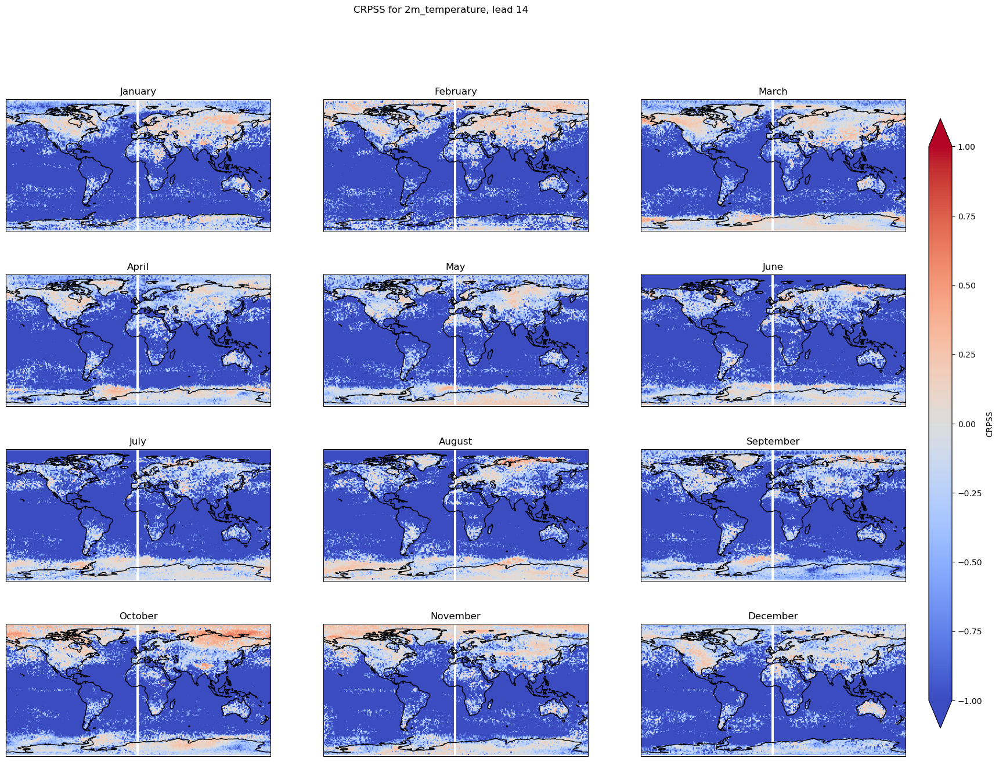

<xarray.DataArray 'crps_wind_speed' ()>
array(-1.90406561) <xarray.DataArray 'crps_wind_speed' ()>
array(0.95962745)


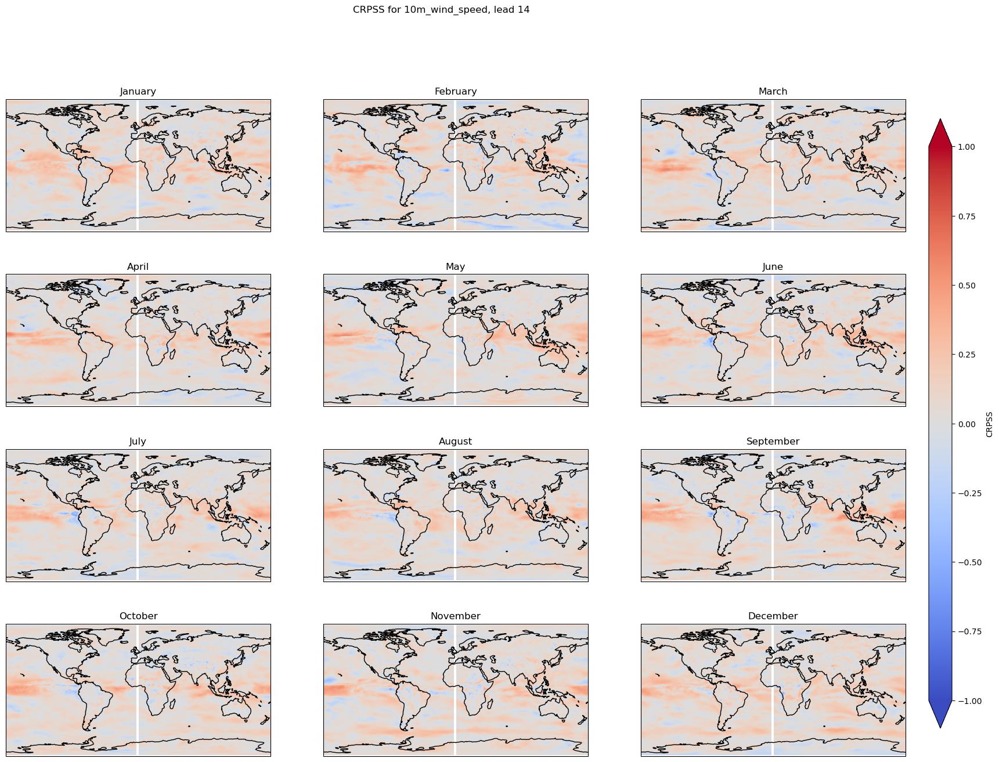

In [53]:
plot_crpss_var_model("2m_temperature", 14, "spatial_month_ensemble", "raw")
plot_crpss_var_model("10m_wind_speed", 14, "spatial_month_ensemble", "raw")

<xarray.DataArray ()>
array(-32.81132126) <xarray.DataArray ()>
array(0.66992116)


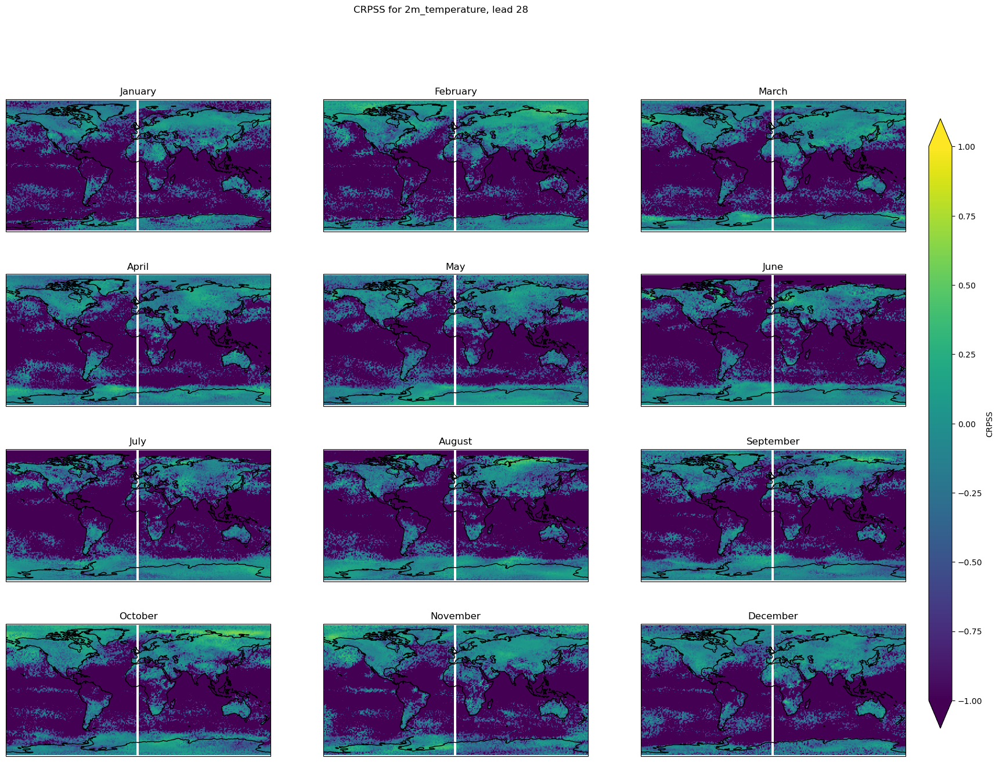

In [35]:
plot_crpss_var("2m_temperature",28)

<xarray.DataArray ()>
array(-31.56534958) <xarray.DataArray ()>
array(0.7187686)


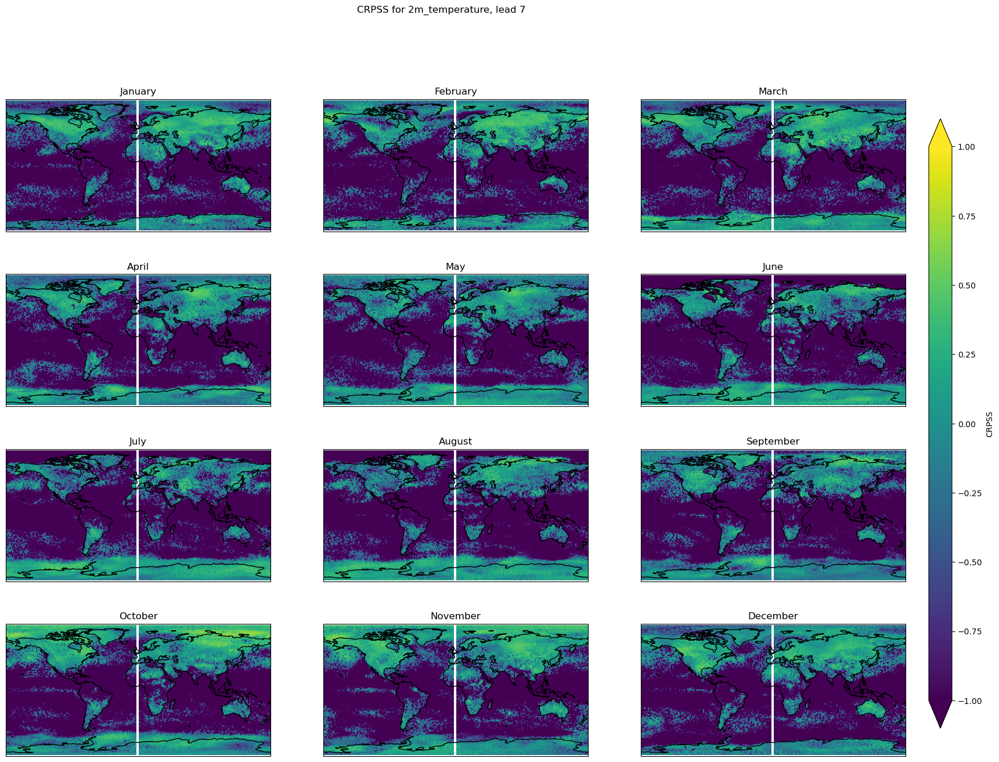

<xarray.DataArray ()>
array(-26.49036026) <xarray.DataArray ()>
array(0.68801272)


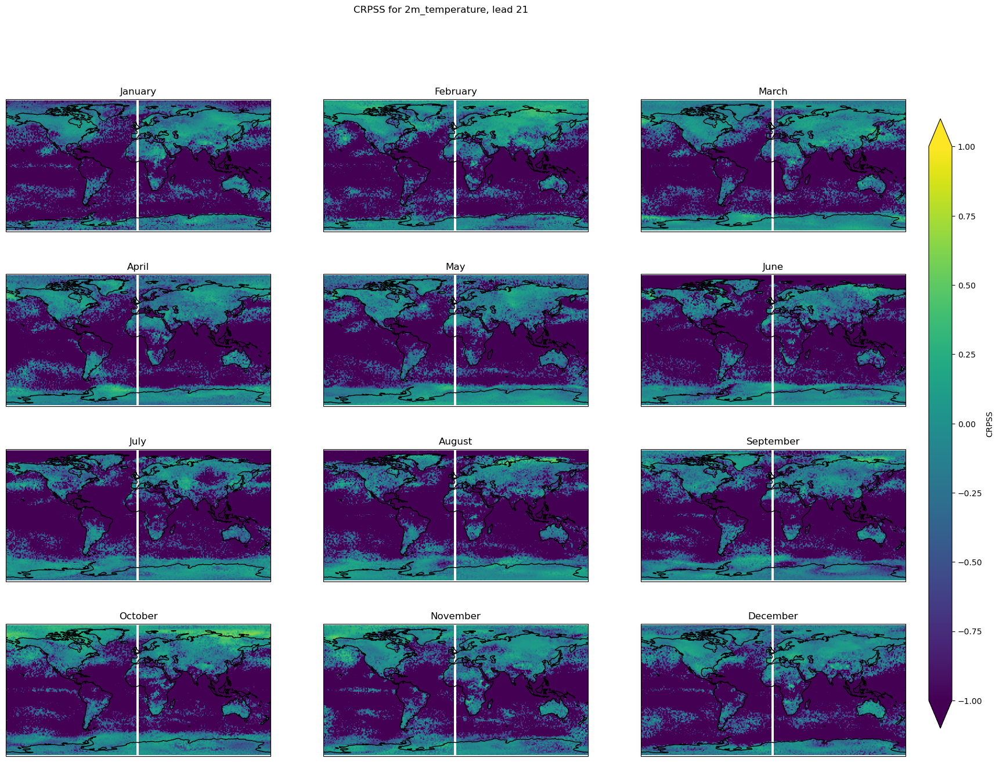

<xarray.DataArray ()>
array(-34.17143631) <xarray.DataArray ()>
array(0.68700194)


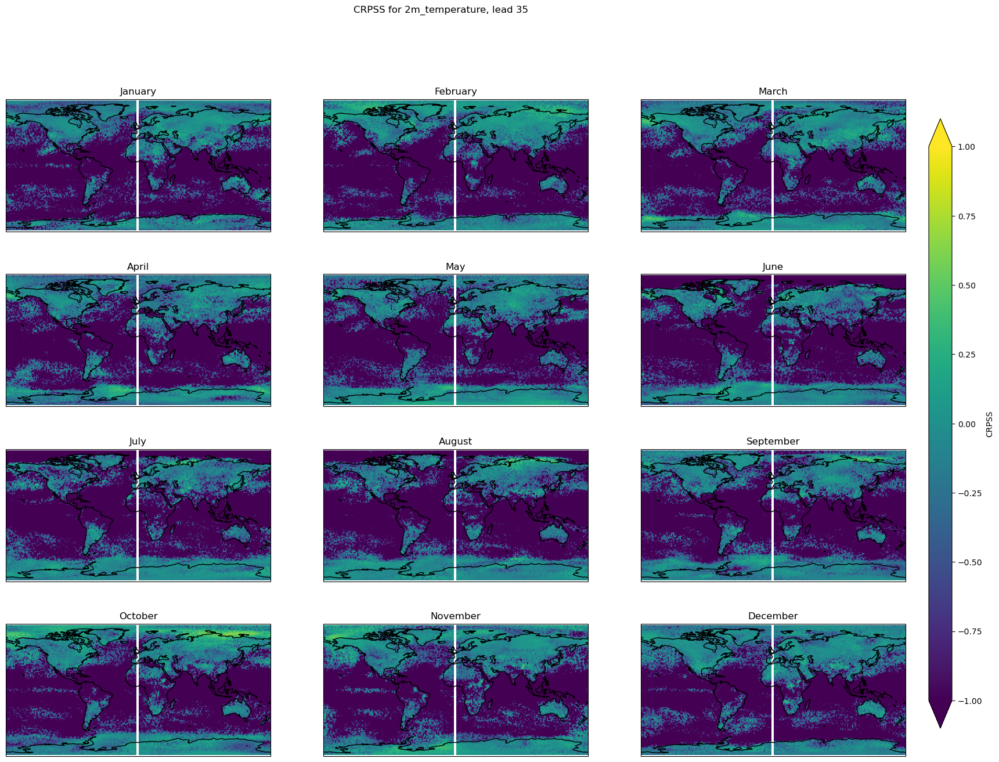

In [4]:
for lead in [7,21,35]:
    plot_crpss_var("2m_temperature", lead)

<xarray.DataArray ()>
array(-30.01061058) <xarray.DataArray ()>
array(0.73272896)


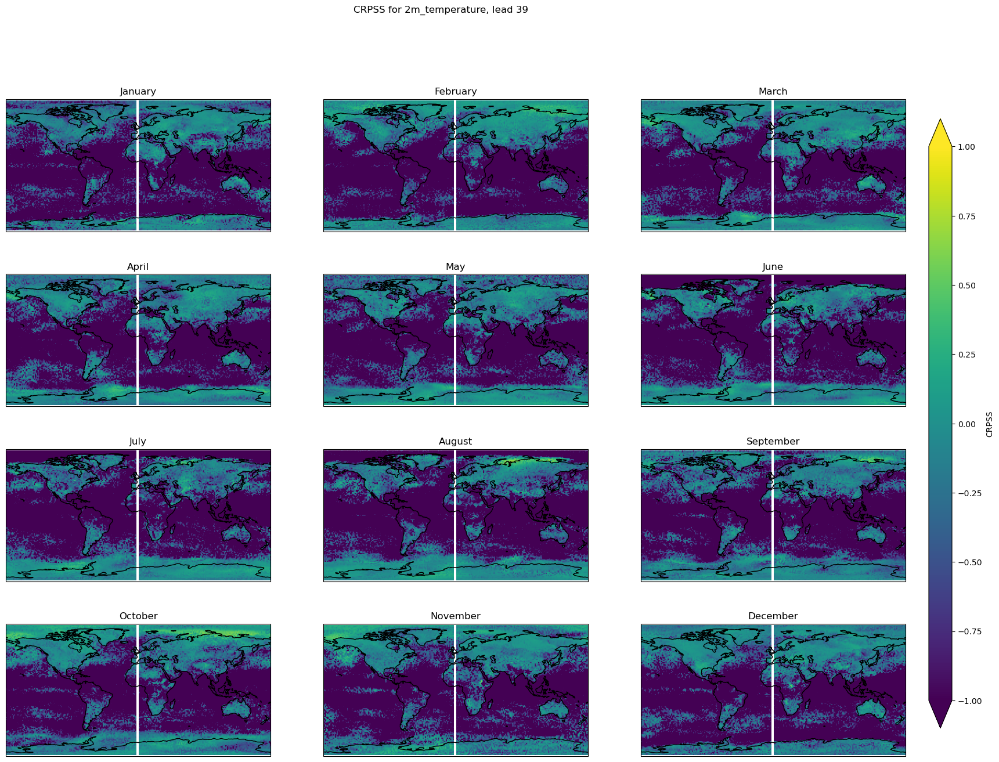

In [5]:
plot_crpss_var("2m_temperature", 39)

training_results/spatial_month/lead28/training_2_spatial_month1_10m_wind_speed_lead=28/crps_14.nc
Month: <xarray.DataArray ()>
array(0.03192291, dtype=float32) <xarray.DataArray ()>
array(0.42114842) <xarray.DataArray ()>
array(-0.45040524)
training_results/spatial_month/lead28/training_4_spatial_month2_10m_wind_speed_lead=28/crps_14.nc
Month: <xarray.DataArray ()>
array(0.01137386, dtype=float32) <xarray.DataArray ()>
array(0.37960464) <xarray.DataArray ()>
array(-0.88438308)
training_results/spatial_month/lead28/training_6_spatial_month3_10m_wind_speed_lead=28/crps_14.nc
Month: <xarray.DataArray ()>
array(0.02845456, dtype=float32) <xarray.DataArray ()>
array(0.51244855) <xarray.DataArray ()>
array(-0.40184236)
training_results/spatial_month/lead28/training_8_spatial_month4_10m_wind_speed_lead=28/crps_14.nc
Month: <xarray.DataArray ()>
array(0.0302275, dtype=float32) <xarray.DataArray ()>
array(0.44232094) <xarray.DataArray ()>
array(-0.36247003)
training_results/spatial_month/lead28

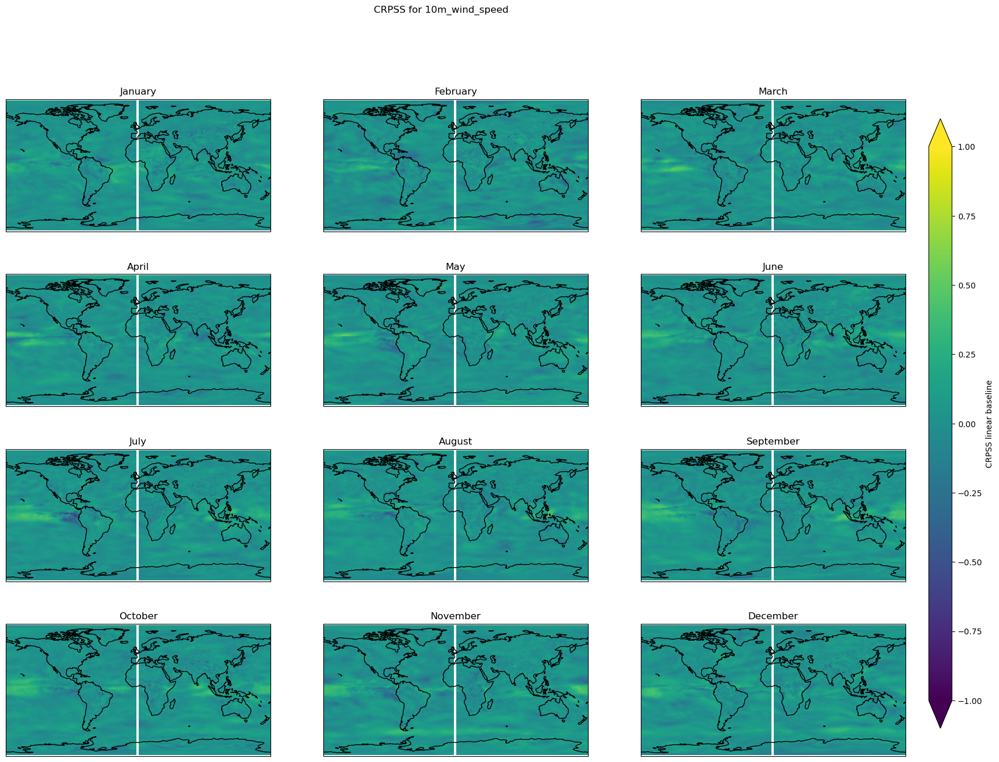

In [16]:
plot_crpss_var("10m_wind_speed",28)

<xarray.DataArray ()>
array(-0.90905988) <xarray.DataArray ()>
array(0.65870082)


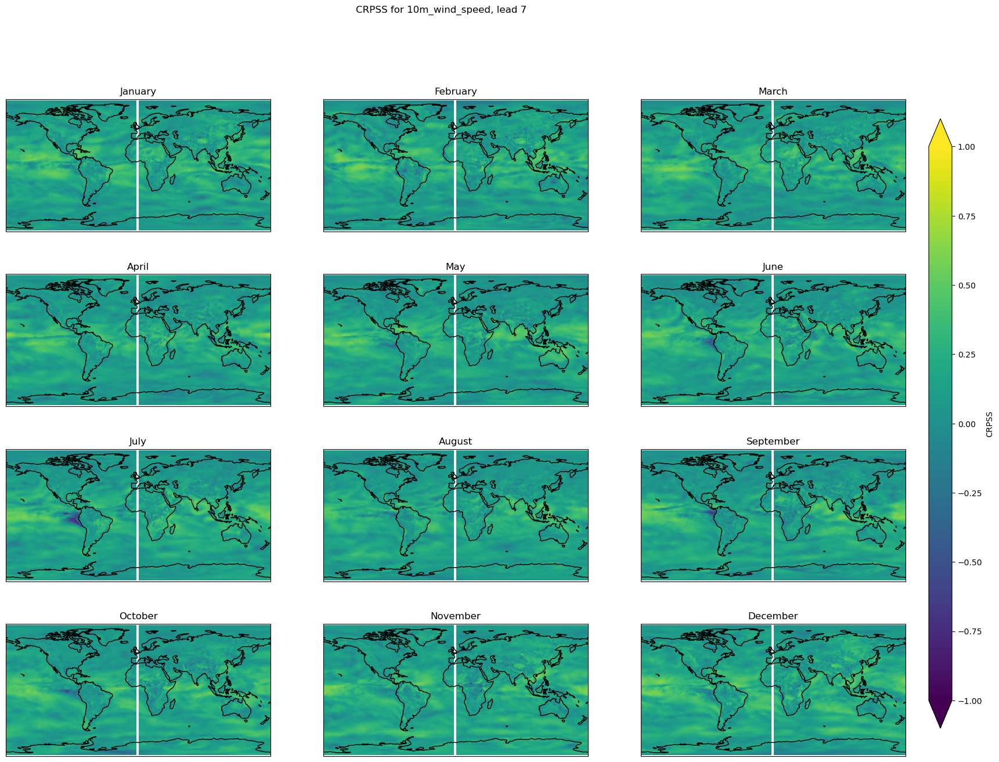

<xarray.DataArray ()>
array(-0.80881977) <xarray.DataArray ()>
array(0.57467753)


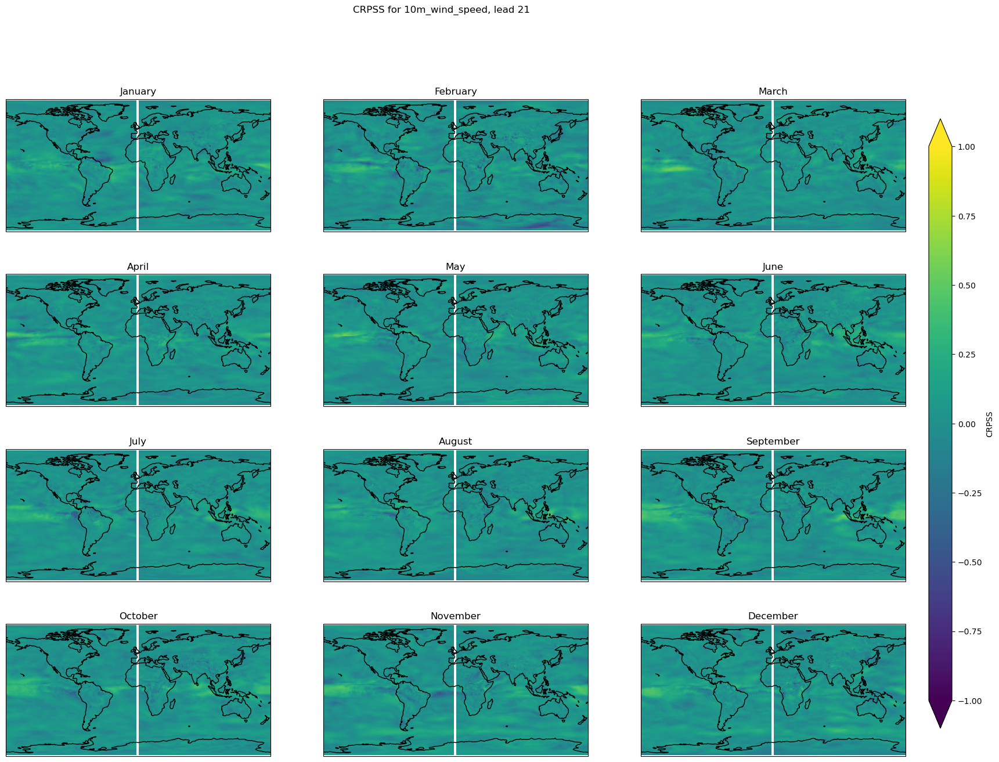

<xarray.DataArray ()>
array(-1.18354177) <xarray.DataArray ()>
array(0.54900002)


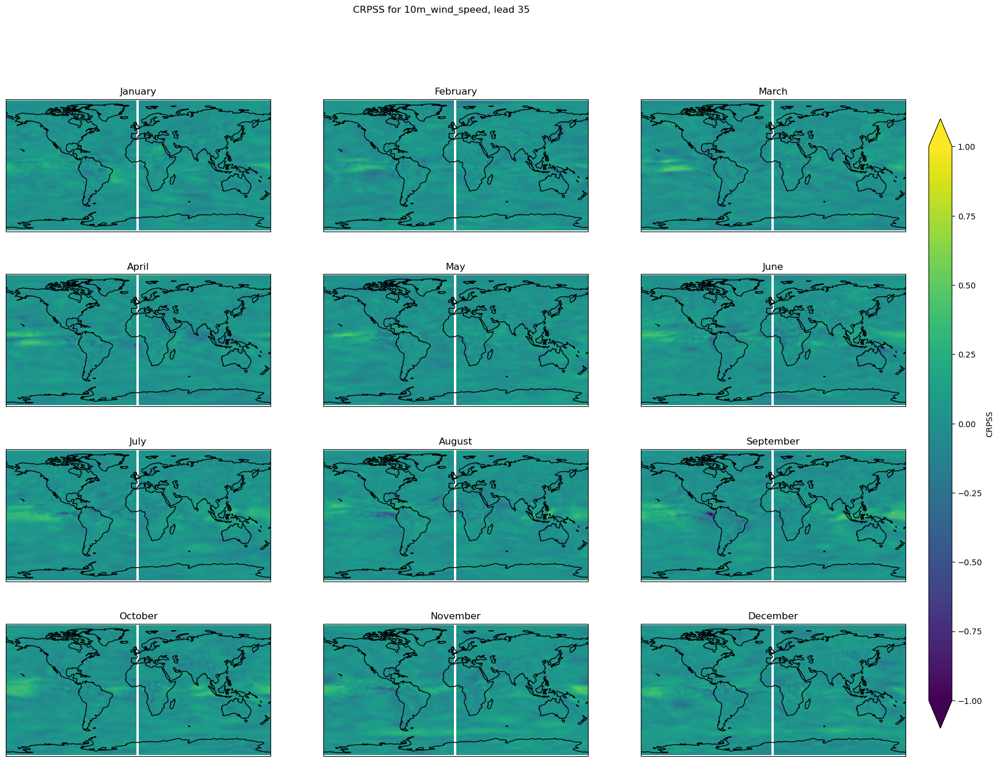

<xarray.DataArray ()>
array(-0.76893342) <xarray.DataArray ()>
array(0.54464769)


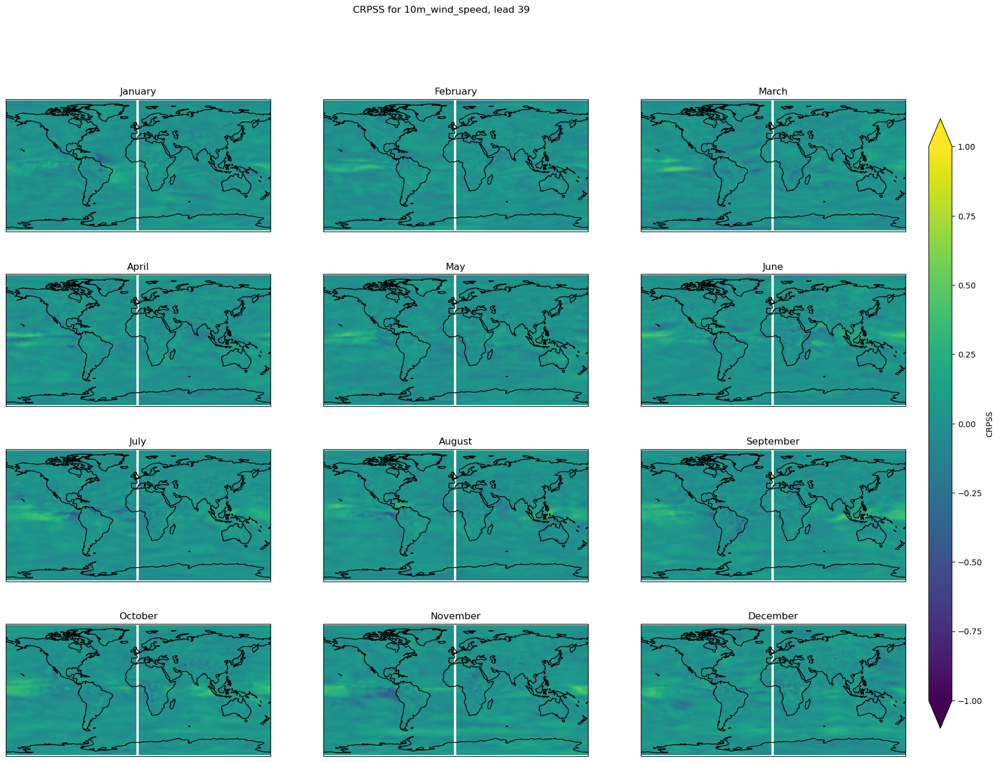

In [6]:
for lead in [7,21,35,39]:
    plot_crpss_var("10m_wind_speed", lead)

### Visualize mean and std fields 
Look if the model converged (std still noisy for t2m for now, wind speed converged)

In [9]:
from processings.dataset import WeatherDataset, WeatherEnsembleDataset
from torch.utils.data import DataLoader
from model import SpatialMOS, SpatialEMOS , SpatialEMOSprior
from metrics import compute_crps_normal
from sklearn.metrics import root_mean_squared_error
import torch

def compute_inference(variable, train_index, month, lead_time, exp_name, id, projection=ccrs.PlateCarree()):
    index2month = {1: "January", 2: "February", 3: "March", 4: "April", 5: "May", 6: "June", 7: "July", 8: "August", 9: "September", 10: "October", 11: "November", 12: "December"}
    base_dir = f"training_results/{exp_name}/lead{lead_time}"
    data_folder = "/home/majanvie/scratch/data" 
    test_folder = f"{data_folder}/test/EMOS"
    obs_folder = f"{data_folder}/raw/obs"
    if variable == "2m_temperature":
        epoch = 9
    elif variable == "10m_wind_speed":
        epoch = 14
    valid_years = [2018,2022]
    if id is not None:
        model_folder = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}_{id}"
    else:
        model_folder = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}"

    test_dataset = WeatherEnsembleDataset(
        data_path=test_folder,
        obs_path=obs_folder,
        target_variable=variable,
        lead_time_idx=lead_time,
        valid_years=valid_years,
        valid_months=[month,month],
        subset="test")
    print(len(test_dataset.data_index))
    test_loader = DataLoader(test_dataset, batch_size=1, shuffle=True)

    # load model weights
    if id is not None:
        model =SpatialEMOSprior(66,121,240,4)
    else:
        model = SpatialEMOS(66, 121, 240, 4)
    model.load_state_dict(torch.load(
        f"{model_folder}/model_{epoch}.pth"
        ))
    model.eval()

    # Compute performance metrics
    m_list = []
    std_list =[]
    crps_list = []
    rmse_list = []
    for batch in test_loader:
        mu = batch['mu']
        sigma = batch['sigma']
        X = batch['input']
        y = batch['truth']
        print("input",X.mean(), X.std())
        out_distrib= model(mu, sigma, X, y)
        
        # get mean, std of distrib 
        mean = out_distrib.loc
        std = out_distrib.scale
        #rmse = root_mean_squared_error(y[0].detach().numpy(), mean[0].detach().numpy(), multioutput='raw_values')
        rmse = np.abs(y[0].detach().numpy() - mean[0].detach().numpy())
        m_list.append(mean)
        std_list.append(std)
        rmse_list.append(rmse)
        
        crps_var = compute_crps_normal(model, batch).detach().numpy()  # shape (1, lat, lon)
        crps_list.append(crps_var)
    return m_list, std_list, rmse_list, crps_list, test_dataset
    

def plot_best_worst(m_list, std_list, crps_list, test_dataset, variable):
    lats = test_dataset.latitude
    lons = test_dataset.longitude

    # get best and worst crps indices 
    crps_list_mean = [crps.mean() for crps in crps_list]
    bad_index = np.argmax(crps_list_mean)
    best_index = np.argmin(crps_list_mean)

    # plot 
    fig, axes = plt.subplots(2, 2, figsize=(20, 15), subplot_kw={'projection': ccrs.PlateCarree()})
    fig.suptitle(f"Mean, STD of best and worst CRPS for {variable}")
    data_list = [m_list[bad_index], m_list[best_index], std_list[bad_index], std_list[best_index]]
    min_mean, max_mean = min([data.min() for data in data_list[:3]]), max([data.max() for data in data_list[:3]])
    min_std, max_std = min([data.min() for data in data_list[3:]]), max([data.max() for data in data_list[3:]])
    norm_mean = plt.Normalize(vmin=min_mean, vmax=max_mean)
    if variable == "2m_temperature":
        norm_mean = plt.Normalize(vmin=220, vmax=330)
    norm_std = plt.Normalize(vmin=min_std, vmax=max_std)

    for i, data in enumerate(data_list):
        ax = axes[i//2, i%2]
        ax.set_extent([lons.min(), lons.max(), lats.min(), lats.max()], crs=ccrs.PlateCarree())
        ax.coastlines()
        
        if i < 2:
            im = ax.imshow(data.detach().numpy()[0], origin='lower', extent=[lons.min(), lons.max(), lats.min(), lats.max()],
            transform=ccrs.PlateCarree(), cmap='viridis', norm=norm_mean)
            ax.set_title(f"Mean of {variable} for {['worst', 'best'][i%2]} CRPS")
        else:
            im = ax.imshow(data.detach().numpy()[0], origin='lower', extent=[lons.min(), lons.max(), lats.min(), lats.max()],
            transform=ccrs.PlateCarree(), cmap='viridis', norm=norm_std)
            ax.set_title(f"STD of {variable} for {['worst', 'best'][i%2]} CRPS")

        # Add colorbars for each row of subplots
        if i ==1:
            cbar_ax_mean = fig.add_axes([0.92, 0.55, 0.02, 0.35])  # [left, bottom, width, height]
            cbar_mean = fig.colorbar(im, cax=cbar_ax_mean, label="Mean " + variable, extend='both', norm=norm_mean)
        elif i == 3:
            cbar_ax_std = fig.add_axes([0.92, 0.1, 0.02, 0.35])  # [left, bottom, width, height]
            cbar_std = fig.colorbar(im, cax=cbar_ax_std, label="STD " + variable, extend='both', norm=norm_std)

    plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to accommodate colorbars
    plt.show()




#### t2m prior

(2904, 121, 240)
(2904, 29040)
44
(29040,)
input tensor(-0.0004) tensor(0.9985)
tensor(0.0023, grad_fn=<MeanBackward0>) tensor(0.0108, grad_fn=<MeanBackward0>) tensor(-0.7332, grad_fn=<MeanBackward0>) tensor(0.6686, grad_fn=<MeanBackward0>)
tensor(0.0023, grad_fn=<MeanBackward0>) tensor(0.0108, grad_fn=<MeanBackward0>) tensor(-0.7332, grad_fn=<MeanBackward0>) tensor(0.6686, grad_fn=<MeanBackward0>)
(29040,)
input tensor(-0.0003) tensor(0.9984)
tensor(0.0023, grad_fn=<MeanBackward0>) tensor(0.0108, grad_fn=<MeanBackward0>) tensor(-0.7338, grad_fn=<MeanBackward0>) tensor(0.6681, grad_fn=<MeanBackward0>)
tensor(0.0023, grad_fn=<MeanBackward0>) tensor(0.0108, grad_fn=<MeanBackward0>) tensor(-0.7338, grad_fn=<MeanBackward0>) tensor(0.6681, grad_fn=<MeanBackward0>)
(29040,)
input tensor(-0.0004) tensor(0.9977)
tensor(0.0023, grad_fn=<MeanBackward0>) tensor(0.0108, grad_fn=<MeanBackward0>) tensor(-0.7335, grad_fn=<MeanBackward0>) tensor(0.6680, grad_fn=<MeanBackward0>)
tensor(0.0023, grad_fn=

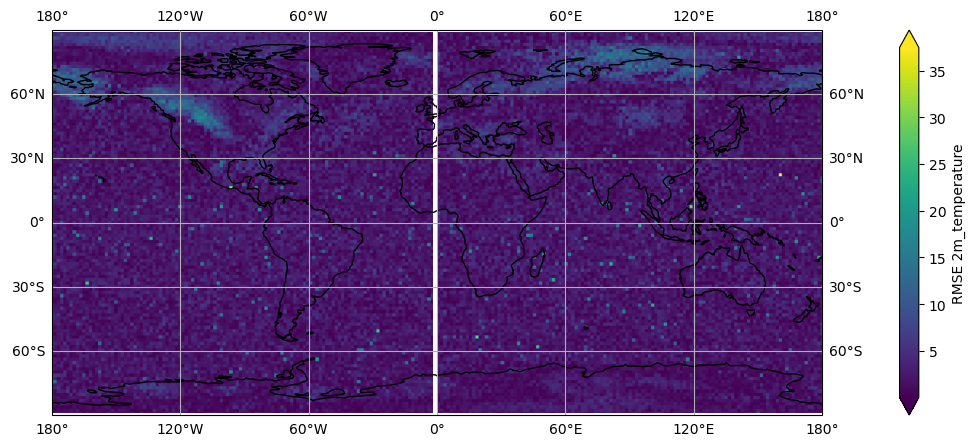

/tmp/ipykernel_127692/4099444046.py:114: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to accommodate colorbars


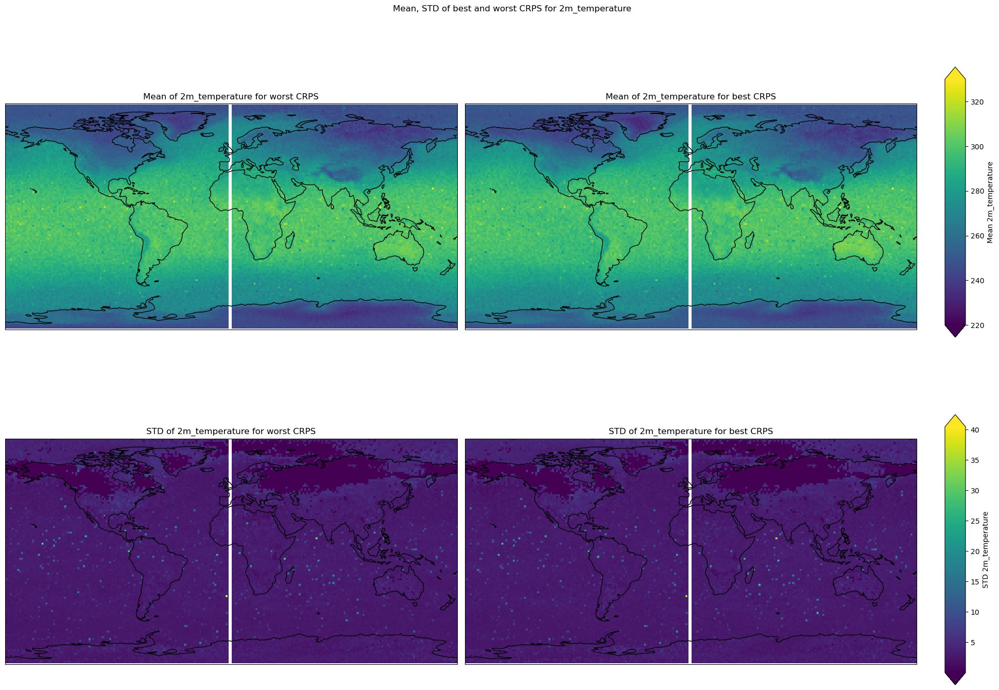

In [10]:
m_list, std_list, rmse_list, crps_list, test_dataset = compute_inference("2m_temperature", train_index=32, month=1, lead_time=14, id="prior", exp_name="spatial_month_ensemble")
plot_map(test_dataset.latitude, test_dataset.longitude, rmse_list[0], "RMSE 2m_temperature")
plot_best_worst(m_list, std_list, crps_list, test_dataset, "2m_temperature")

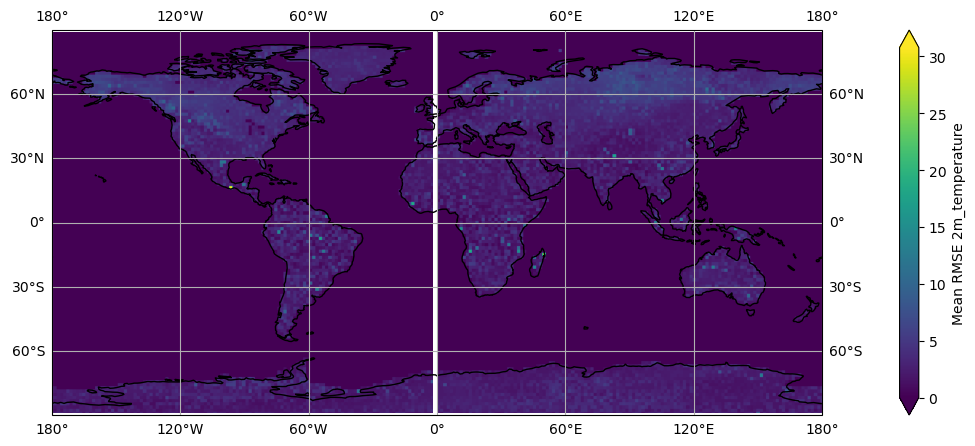

0.0 38.973328
<xarray.DataArray 'land_sea_mask' ()>
array(0.) <xarray.DataArray 'land_sea_mask' ()>
array(30.77774811)
<xarray.DataArray 'land_sea_mask' ()>
array(1.0587747, dtype=float32)


In [43]:
# get mean, min, max over rmse_list
# stack for mean 
rmse = np.stack(rmse_list, axis=0)
mean_rmse = rmse.mean(axis=0) * land_sea_mask
min_rmse = rmse.min()
max_rmse = rmse.max()
plot_map(test_dataset.latitude, test_dataset.longitude, mean_rmse, "Mean RMSE 2m_temperature")
mmin_rmse = (mean_rmse).min()
mmax_rmse = (mean_rmse).max()
print(min_rmse, max_rmse)
print(mmin_rmse,mmax_rmse)
print(mean_rmse.mean())


#### wind prior

44
tensor(-0.5327, grad_fn=<MeanBackward0>) tensor(1.9224, grad_fn=<MeanBackward0>) tensor(-0.9277, grad_fn=<MeanBackward0>) tensor(0.0376, grad_fn=<MeanBackward0>)
tensor(-0.5327, grad_fn=<MeanBackward0>) tensor(1.9224, grad_fn=<MeanBackward0>) tensor(-0.9277, grad_fn=<MeanBackward0>) tensor(0.0376, grad_fn=<MeanBackward0>)
tensor(-0.5331, grad_fn=<MeanBackward0>) tensor(1.9241, grad_fn=<MeanBackward0>) tensor(-0.9285, grad_fn=<MeanBackward0>) tensor(0.0375, grad_fn=<MeanBackward0>)
tensor(-0.5331, grad_fn=<MeanBackward0>) tensor(1.9241, grad_fn=<MeanBackward0>) tensor(-0.9285, grad_fn=<MeanBackward0>) tensor(0.0375, grad_fn=<MeanBackward0>)
tensor(-0.5330, grad_fn=<MeanBackward0>) tensor(1.9240, grad_fn=<MeanBackward0>) tensor(-0.9285, grad_fn=<MeanBackward0>) tensor(0.0376, grad_fn=<MeanBackward0>)
tensor(-0.5330, grad_fn=<MeanBackward0>) tensor(1.9240, grad_fn=<MeanBackward0>) tensor(-0.9285, grad_fn=<MeanBackward0>) tensor(0.0376, grad_fn=<MeanBackward0>)
tensor(-0.5340, grad_fn=<

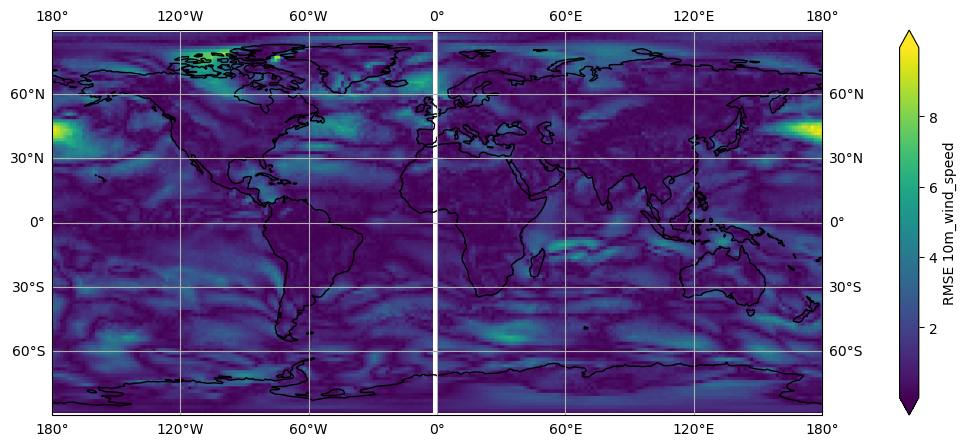

/tmp/ipykernel_12456/1702972187.py:113: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to accommodate colorbars


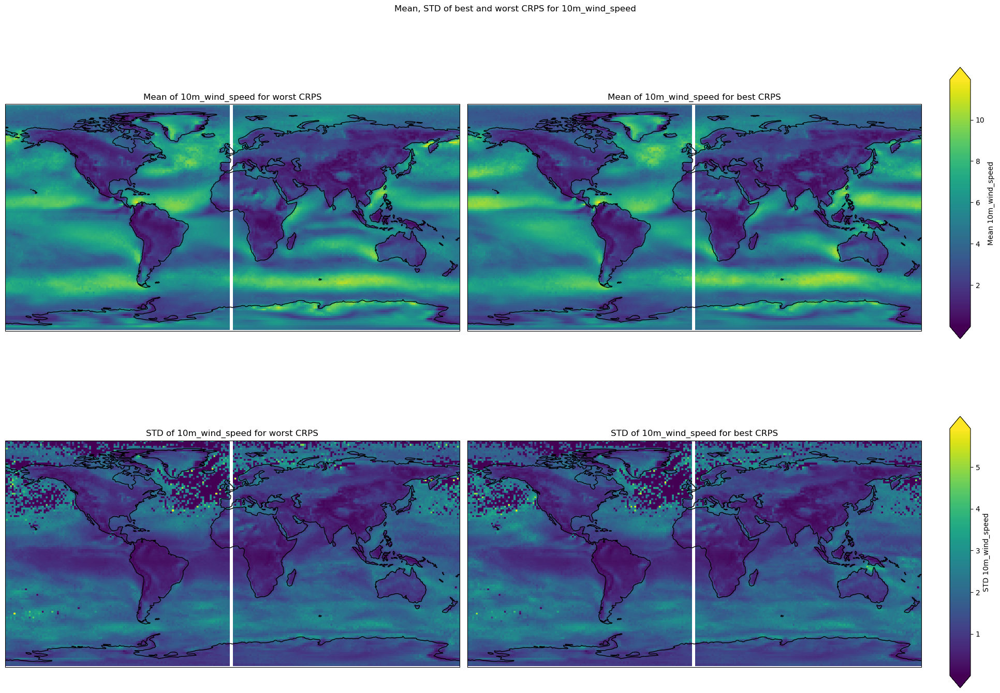

In [5]:
m_list, std_list, rmse_list, crps_list, test_dataset = compute_inference("10m_wind_speed", train_index=33, month=1, lead_time=14, id="prior", exp_name="spatial_month_ensemble")
plot_map(test_dataset.latitude, test_dataset.longitude, rmse_list[0], "RMSE 10m_wind_speed")
plot_best_worst(m_list, std_list, crps_list, test_dataset, "10m_wind_speed")

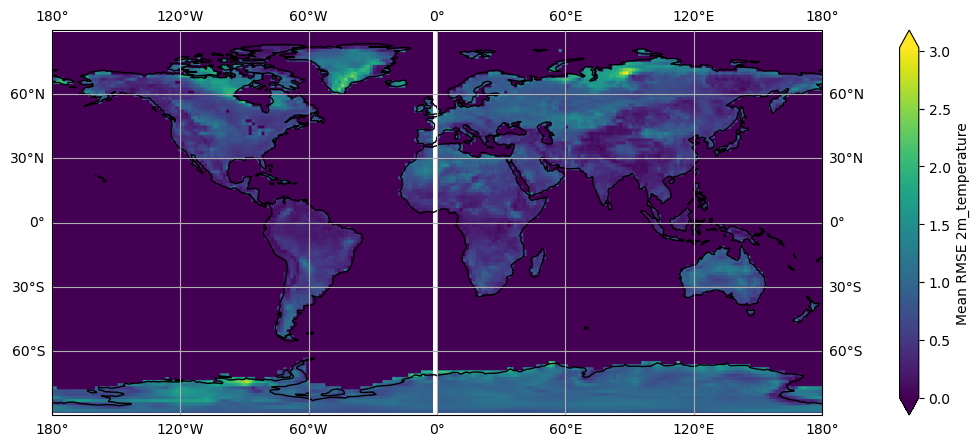

1.4305115e-06 14.320381
<xarray.DataArray 'land_sea_mask' ()>
array(0.) <xarray.DataArray 'land_sea_mask' ()>
array(3.02786875)
<xarray.DataArray 'land_sea_mask' ()>
array(0.2671788, dtype=float32)


In [8]:
# get mean, min, max over rmse_list
# stack for mean 
rmse = np.stack(rmse_list, axis=0)
mean_rmse = rmse.mean(axis=0) * land_sea_mask
min_rmse = rmse.min()
max_rmse = rmse.max()
plot_map(test_dataset.latitude, test_dataset.longitude, mean_rmse, "Mean RMSE 2m_temperature")
mmin_rmse = (mean_rmse).min()
mmax_rmse = (mean_rmse).max()
print(min_rmse, max_rmse)
print(mmin_rmse,mmax_rmse)
print(mean_rmse.mean())


#### t2m no prior 1 

44
tensor(0.9974, grad_fn=<MeanBackward0>) tensor(1.0042, grad_fn=<MeanBackward0>) tensor(-0.0962, grad_fn=<MeanBackward0>) tensor(1.2989, grad_fn=<MeanBackward0>)
tensor(0.9974, grad_fn=<MeanBackward0>) tensor(1.0042, grad_fn=<MeanBackward0>) tensor(-0.0962, grad_fn=<MeanBackward0>) tensor(1.2989, grad_fn=<MeanBackward0>)
tensor(0.9988, grad_fn=<MeanBackward0>) tensor(1.0056, grad_fn=<MeanBackward0>) tensor(-0.0964, grad_fn=<MeanBackward0>) tensor(1.3017, grad_fn=<MeanBackward0>)
tensor(0.9988, grad_fn=<MeanBackward0>) tensor(1.0056, grad_fn=<MeanBackward0>) tensor(-0.0964, grad_fn=<MeanBackward0>) tensor(1.3017, grad_fn=<MeanBackward0>)
tensor(0.9978, grad_fn=<MeanBackward0>) tensor(1.0045, grad_fn=<MeanBackward0>) tensor(-0.0963, grad_fn=<MeanBackward0>) tensor(1.2997, grad_fn=<MeanBackward0>)
tensor(0.9978, grad_fn=<MeanBackward0>) tensor(1.0045, grad_fn=<MeanBackward0>) tensor(-0.0963, grad_fn=<MeanBackward0>) tensor(1.2997, grad_fn=<MeanBackward0>)
tensor(0.9988, grad_fn=<MeanBac

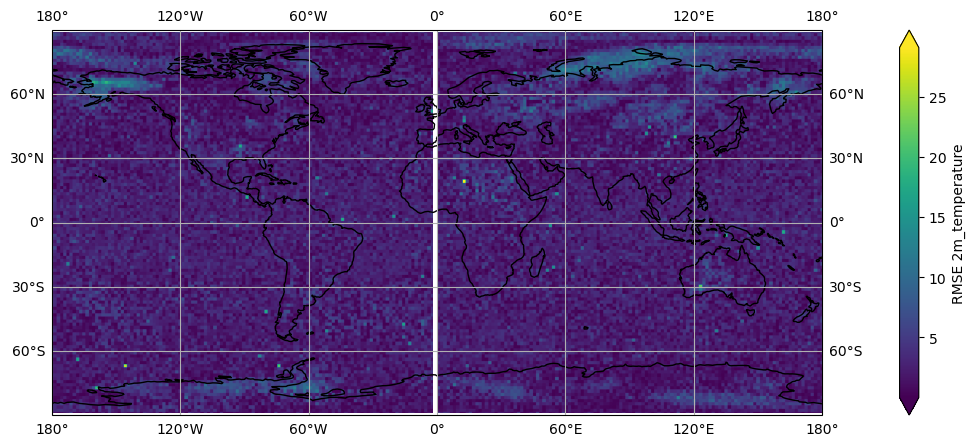

/tmp/ipykernel_73894/1702972187.py:113: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to accommodate colorbars


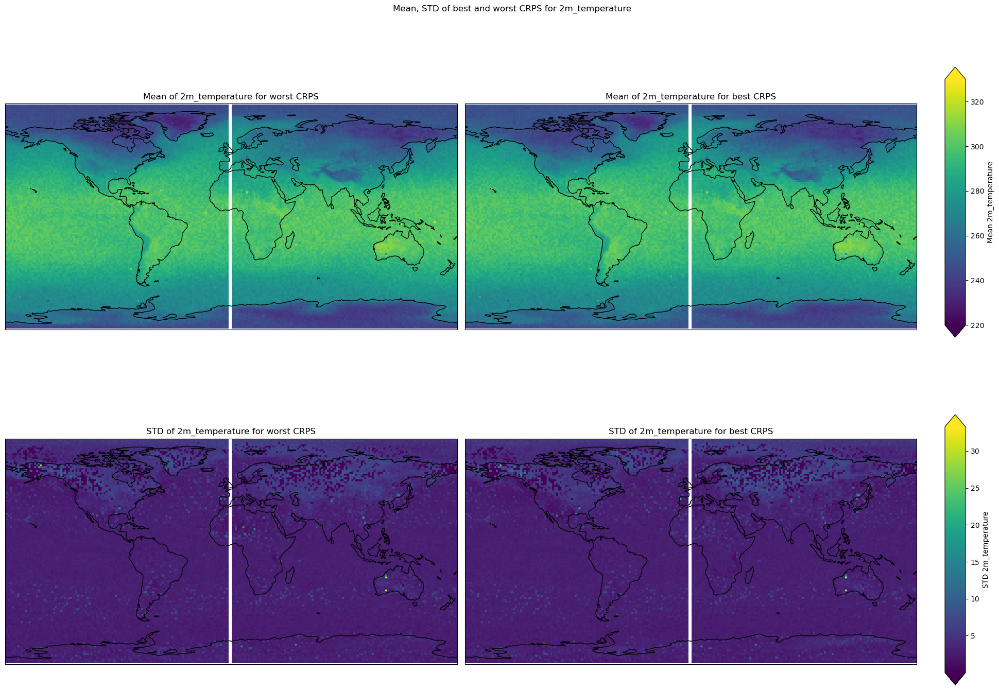

In [16]:
m_list, std_list, rmse_list, crps_list, test_dataset = compute_inference("2m_temperature", train_index=1, month=1, lead_time=14,id=None, exp_name="spatial_month_ensemble")
plot_map(test_dataset.latitude, test_dataset.longitude, rmse_list[0], "RMSE 2m_temperature")
plot_best_worst(m_list, std_list, crps_list, test_dataset, "2m_temperature")

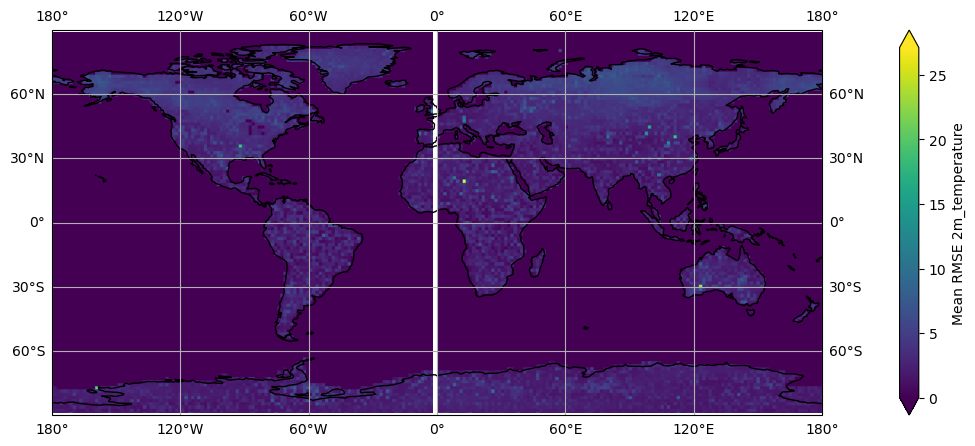

0.0 32.016235
<xarray.DataArray 'land_sea_mask' ()>
array(0.) <xarray.DataArray 'land_sea_mask' ()>
array(27.12195969)
<xarray.DataArray 'land_sea_mask' ()>
array(1.0352995, dtype=float32)


In [10]:
# get mean, min, max over rmse_list
# stack for mean 
rmse = np.stack(rmse_list, axis=0)
mean_rmse = rmse.mean(axis=0) * land_sea_mask
min_rmse = rmse.min()
max_rmse = rmse.max()
plot_map(test_dataset.latitude, test_dataset.longitude, mean_rmse, "Mean RMSE 2m_temperature")
mmin_rmse = (mean_rmse).min()
mmax_rmse = (mean_rmse).max()
print(min_rmse, max_rmse)
print(mmin_rmse,mmax_rmse)
print(mean_rmse.mean())


#### 10m wind no prior 1

44
tensor(0.4906, grad_fn=<MeanBackward0>) tensor(1.7476, grad_fn=<MeanBackward0>) tensor(0.0705, grad_fn=<MeanBackward0>) tensor(0.2464, grad_fn=<MeanBackward0>)
tensor(0.4906, grad_fn=<MeanBackward0>) tensor(1.7476, grad_fn=<MeanBackward0>) tensor(0.0705, grad_fn=<MeanBackward0>) tensor(0.2464, grad_fn=<MeanBackward0>)
tensor(0.4908, grad_fn=<MeanBackward0>) tensor(1.7489, grad_fn=<MeanBackward0>) tensor(0.0706, grad_fn=<MeanBackward0>) tensor(0.2467, grad_fn=<MeanBackward0>)
tensor(0.4908, grad_fn=<MeanBackward0>) tensor(1.7489, grad_fn=<MeanBackward0>) tensor(0.0706, grad_fn=<MeanBackward0>) tensor(0.2467, grad_fn=<MeanBackward0>)
tensor(0.4904, grad_fn=<MeanBackward0>) tensor(1.7474, grad_fn=<MeanBackward0>) tensor(0.0705, grad_fn=<MeanBackward0>) tensor(0.2464, grad_fn=<MeanBackward0>)
tensor(0.4904, grad_fn=<MeanBackward0>) tensor(1.7474, grad_fn=<MeanBackward0>) tensor(0.0705, grad_fn=<MeanBackward0>) tensor(0.2464, grad_fn=<MeanBackward0>)
tensor(0.4907, grad_fn=<MeanBackward0

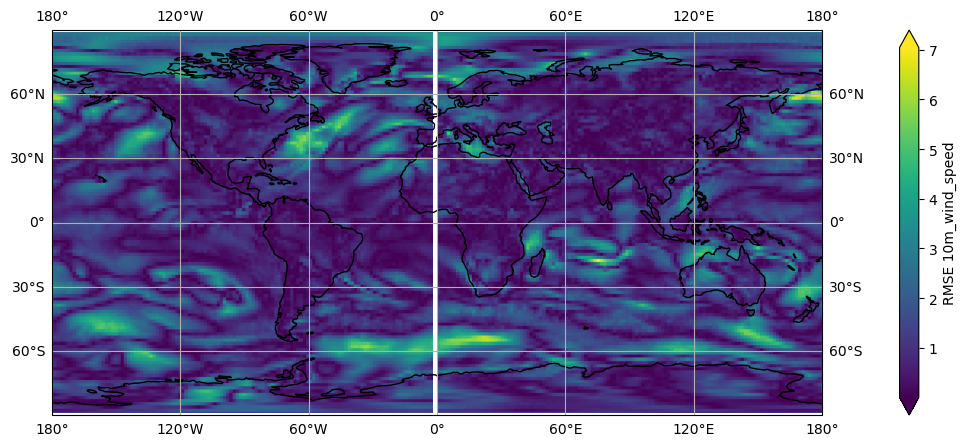

/tmp/ipykernel_12456/1702972187.py:113: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout(rect=[0, 0, 0.9, 1])  # Adjust layout to accommodate colorbars


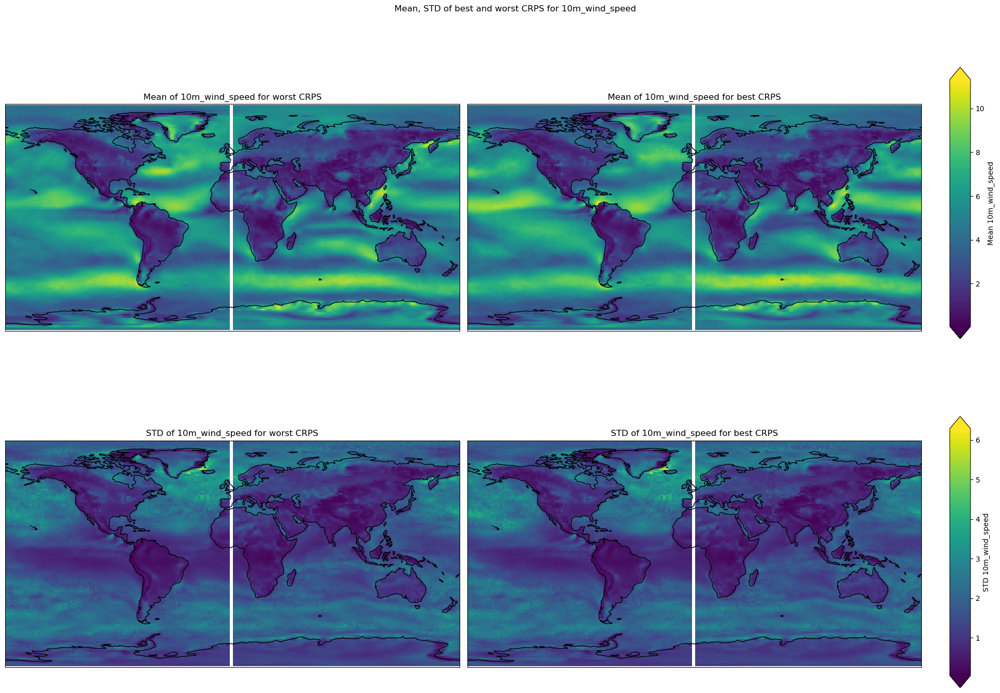

In [11]:
m_list, std_list, rmse_list, crps_list, test_dataset = compute_inference("10m_wind_speed", train_index=2, month=1, lead_time=14,id=None, exp_name="spatial_month_ensemble")
plot_map(test_dataset.latitude, test_dataset.longitude, rmse_list[0], "RMSE 10m_wind_speed")
plot_best_worst(m_list, std_list, crps_list, test_dataset, "10m_wind_speed")

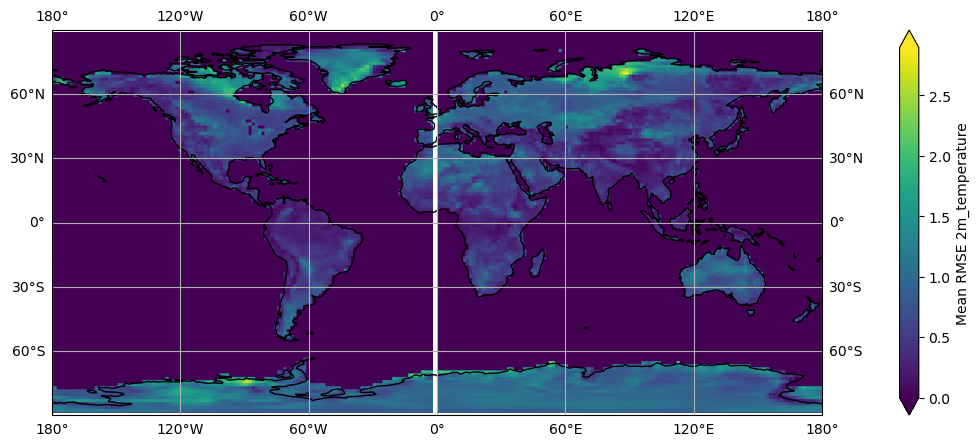

4.7683716e-07 12.230824
<xarray.DataArray 'land_sea_mask' ()>
array(0.) <xarray.DataArray 'land_sea_mask' ()>
array(2.89390326)
<xarray.DataArray 'land_sea_mask' ()>
array(0.26596972, dtype=float32)


In [12]:
# get mean, min, max over rmse_list
# stack for mean 
rmse = np.stack(rmse_list, axis=0)
mean_rmse = rmse.mean(axis=0) * land_sea_mask
min_rmse = rmse.min()
max_rmse = rmse.max()
plot_map(test_dataset.latitude, test_dataset.longitude, mean_rmse, "Mean RMSE 2m_temperature")
mmin_rmse = (mean_rmse).min()
mmax_rmse = (mean_rmse).max()
print(min_rmse, max_rmse)
print(mmin_rmse,mmax_rmse)
print(mean_rmse.mean())


#### searching problematic pixels 

In [19]:
std_list[10][0].detach().numpy().min()

5.3255713e-05

Shape of indices array: (100,)
Indices: (array([101, 107, 108, 101, 102, 107, 103, 109, 107, 103, 101, 100, 106,
       106, 103, 104, 103, 104, 106, 105, 103, 104, 101, 100, 102, 101,
       102, 102, 105, 104, 107,  99, 104, 102, 101, 108, 100,  99, 107,
       102, 103, 104, 106, 102, 104, 105, 103, 105, 105, 100, 103, 101,
       102, 102, 104, 108, 104, 106, 103, 101, 101,  95, 103, 105,  99,
       102, 101,  99, 102, 105, 112,  93, 102, 100,  99, 103, 110, 103,
       103, 104, 103, 105, 106, 104, 108,  97, 100,  98, 102, 105, 101,
       104, 104, 105, 106, 106, 102, 106, 101,  99]), array([134,  51,  53, 136, 135,  52, 114,  57,  57,  44, 133, 192,  54,
        55,  58,  55,  47,  47, 140,  39, 136, 151, 135, 137,  56, 190,
       134,  64,  50,  54,  48,  61,  45,  52, 112,  47, 135,  38,  55,
       131, 117, 135,  52,  38,  44,  34, 135,  43,  55,  49, 118, 132,
       194, 111, 118,  59,  37, 136, 192,  51,  70,  51,  49,  38, 136,
        63,  36,  52, 138,  46, 204,  54,

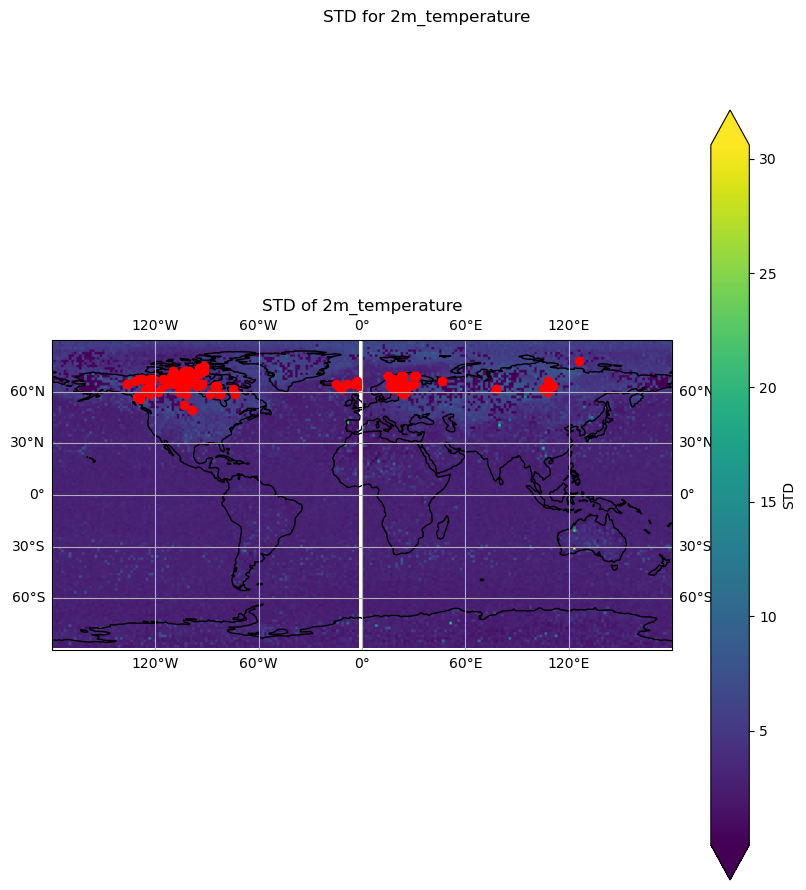

In [17]:
import numpy as np
import matplotlib.pyplot as plt
import cartopy.crs as ccrs

# Get indices of values below 0.1
el = std_list[0][0].detach().numpy()
filtered_indices = np.where(el < 0.1)

# Extract filtered values and flatten them
filtered_values = el[filtered_indices]
filtered_values_flat = filtered_values.flatten()

# Get the indices of the 10 smallest values within the filtered subset
el_sorted_indices = filtered_values_flat.argsort()[:100]

# Get the corresponding 2D indices from the original filtered indices
el_2d_indices = (filtered_indices[0][el_sorted_indices], filtered_indices[1][el_sorted_indices])

print("Shape of indices array:", el_2d_indices[0].shape)
print("Indices:", el_2d_indices)

print("STD value at first index:", std_list[0][0][el_2d_indices[0][0], el_2d_indices[1][0]])

# Build rectangle around the indices on the map
lats = test_dataset.latitude
lons = test_dataset.longitude



lat_min, lat_max = lats.min(), lats.max()
lon_min, lon_max = lons.min(), lons.max()

fig, ax = plt.subplots(1, 1, figsize=(10, 10), subplot_kw={'projection': ccrs.PlateCarree()})
fig.suptitle("STD for 2m_temperature")
ax.set_extent([lon_min, lon_max, lat_min, lat_max], crs=ccrs.PlateCarree())
ax.coastlines()

# Plot the std map
im = ax.imshow(std_list[0][0].detach().numpy(), origin='lower', extent=[lon_min, lon_max, lat_min, lat_max], transform=ccrs.PlateCarree(), cmap='viridis')

# Add lat/lon grid
ax.gridlines(draw_labels=True)
ax.set_title("STD of 2m_temperature")

# Plot the 10 smallest std points
lons = lons -180
for i in range(len(el_2d_indices[0])):
    lat_idx, lon_idx = el_2d_indices[0][i], el_2d_indices[1][i]
    ax.plot(lons[lon_idx], lats[lat_idx], 'ro')

plt.colorbar(im, label="STD", extend='both')
plt.show()


## Data

In [2]:
import xarray as xr
def compute_wind_speedxr(dataset, name):
    """Computes wind speed in place"""
    if name =="data":
        u_name = 'u_component_of_wind'
        v_name = 'v_component_of_wind'
    elif name == "obs":
        u_name = "10m_u_component_of_wind"
        v_name = "10m_v_component_of_wind"
    dataset['10m_wind_speed'] = (dataset[u_name]**2 + dataset[v_name]**2)**0.5
    dataset['10m_wind_speed'].name = '10_wind_speed'


obs_path = "/home/majanvie/scratch/data/raw/obs"
obs = xr.open_mfdataset(obs_path + '/*.nc', combine='by_coords')
compute_wind_speedxr(obs, "obs")
mtrain = xr.open_dataset("/home/majanvie/scratch/data/train/EMOS/mean/data_hindcast=0_forecast=0_20.nc")
stdtrain = xr.open_dataset("/home/majanvie/scratch/data/train/EMOS/std/data_hindcast=0_forecast=0_20.nc")
mtest = xr.open_dataset("/home/majanvie/scratch/data/test/EMOS/mean/data_forecast=0_20.nc")
stdtest = xr.open_dataset("/home/majanvie/scratch/data/test/EMOS/std/data_forecast=0_20.nc")

In [4]:
mtrain

<xarray.Dataset>
Dimensions:                                (forecast_time: 20,
                                            prediction_timedelta: 7,
                                            latitude: 121, longitude: 240)
Coordinates:
  * forecast_time                          (forecast_time) datetime64[ns] 201...
    hindcast_year                          int32 ...
  * latitude                               (latitude) float32 -90.0 ... 90.0
  * longitude                              (longitude) float32 0.0 1.5 ... 358.5
  * prediction_timedelta                   (prediction_timedelta) timedelta64[ns] ...
    time                                   (forecast_time) datetime64[ns] ...
    valid_time                             (forecast_time, prediction_timedelta) datetime64[ns] ...
    level                                  int32 ...
Data variables: (12/66)
    2m_dewpoint_temperature                (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    2m_temperature                         (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    2m_temperature_max                     (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    2m_temperature_min                     (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    convective_available_potential_energy  (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    sea_ice_cover                          (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    ...                                     ...
    geopotential_1000                      (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    specific_humidity_1000                 (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    temperature_1000                       (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    u_component_of_wind_1000               (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    v_component_of_wind_1000               (forecast_time, prediction_timedelta, latitude, longitude) float32 ...
    10m_wind_speed                         (forecast_time, prediction_timedelta, latitude, longitude) float32 ...

In [3]:
import pandas as pd
data = mtrain["2m_temperature"].isel(forecast_time=0, prediction_timedelta=1) # lead 14
valid_time = pd.to_datetime(data.valid_time.values.item())
print(valid_time)
data_obs = obs["2m_temperature"].sel(time=valid_time)
plot_map(test_dataset.latitude, test_dataset.longitude,data.values-data_obs.values.T, "train-true", cmap="coolwarm")

1996-01-11 00:00:00


NameError: name 'plot_map' is not defined

2016-01-11 00:00:00


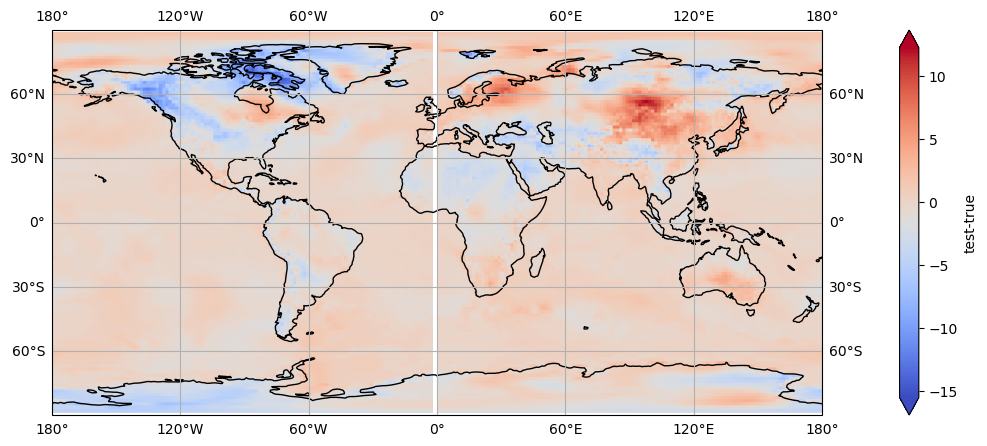

In [18]:
tdata = mtest["2m_temperature"].isel(time=0, prediction_timedelta=1) # lead 14
valid_time = pd.to_datetime(tdata.valid_time.values.item())
print(valid_time)
data_obs = obs["2m_temperature"].sel(time=valid_time)
plot_map(test_dataset.latitude, test_dataset.longitude,tdata.values-data_obs.values.T, "test-true", cmap="coolwarm")

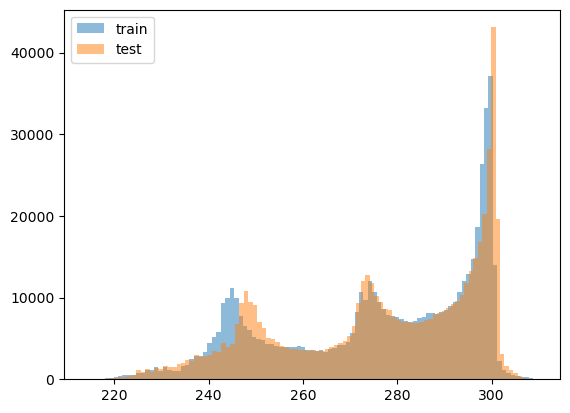

In [30]:
### histogram 
lead_time =1
training = mtrain["2m_temperature"].isel(prediction_timedelta=lead_time).values
testing = mtest["2m_temperature"].isel(prediction_timedelta=lead_time).values

plt.hist(training.flatten(), bins=100, alpha=0.5, label='train')
plt.hist(testing.flatten(), bins=100, alpha=0.5, label='test')
plt.legend(loc='upper left')
plt.show()

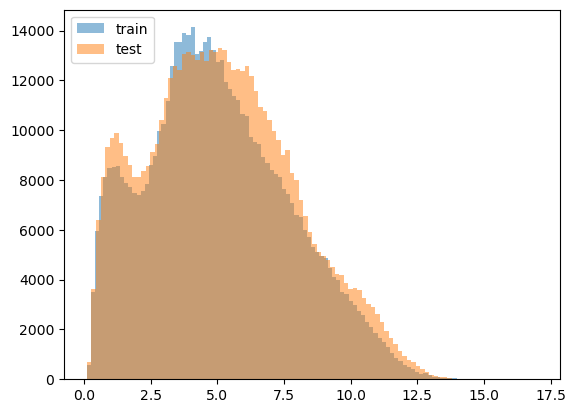

In [46]:
### histogram 
lead_time =1
training = mtrain["10m_wind_speed"].isel(prediction_timedelta=lead_time).values
testing = mtest["10m_wind_speed"].isel(prediction_timedelta=lead_time).values

plt.hist(training.flatten(), bins=100, alpha=0.5, label='train')
plt.hist(testing.flatten(), bins=100, alpha=0.5, label='test')
plt.legend(loc='upper left')
plt.show()

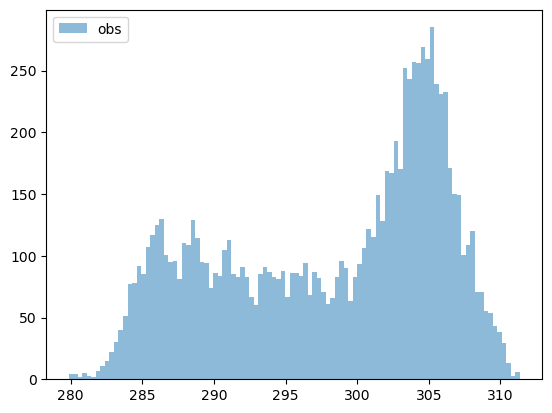

In [109]:
# hypothese de normalité
temp = (obs["2m_temperature"]*land_sea_mask).values[:,50,80]
temp = temp[temp != 0]
plt.hist(temp, bins=100,alpha=0.5,label="obs")
#plt.hist(mtrain["2m_temperature"].isel(prediction_timedelta=0).values[:,84,102],label="train")
#plt.hist(mtest["2m_temperature"].isel(prediction_timedelta=0).values[:,84,102],label="test")
# plt.hist(.values[:,134,101], bins=100, alpha=0.5, label="t2m")
plt.legend(loc='upper left')
plt.show()

(28, 240, 121)


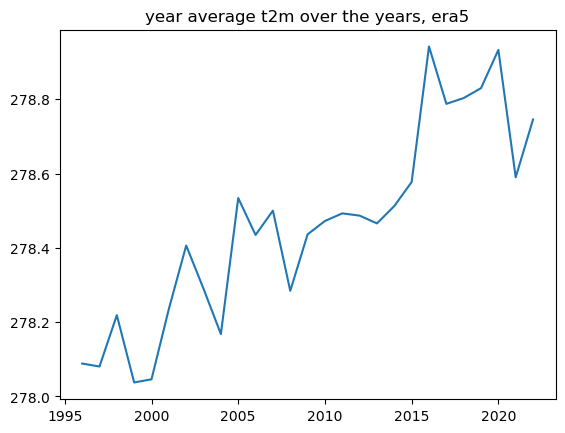

In [13]:
# plot mean per year
years = obs["2m_temperature"].groupby(obs.time.dt.year).mean().year.values
temp_year = obs["2m_temperature"].groupby(obs.time.dt.year).mean().values 
print(temp_year.shape)
plt.plot(years[:-1],temp_year.mean(axis=(1,2))[:-1])
plt.title("year average t2m over the years, era5")
plt.show()

(28, 240, 121)


ValueError: x and y must have same first dimension, but have shapes (25,) and (27,)

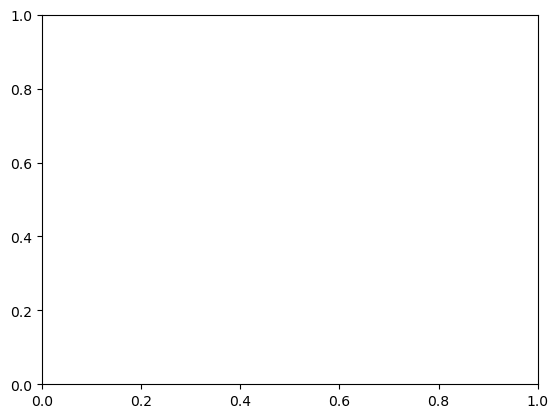

In [13]:
#years = obs["2m_temperature"].groupby(obs.time.dt.year).mean().year.values
temp_year = obs["2m_temperature"].groupby(obs.time.dt.year).mean().values 
print(temp_year.shape)
plt.plot(years[:-1],temp_year.mean(axis=(1,2))[:-1])
plt.title("year average t2m over the years, era5")
plt.show()

[1996 1997 1998 1999 2000 2001 2002 2003 2004 2005 2006 2007 2008 2009
 2010 2011 2012 2013 2014 2015 2016 2017 2018 2019 2020 2021]


ValueError: x and y must have same first dimension, but have shapes (26,) and (121,)

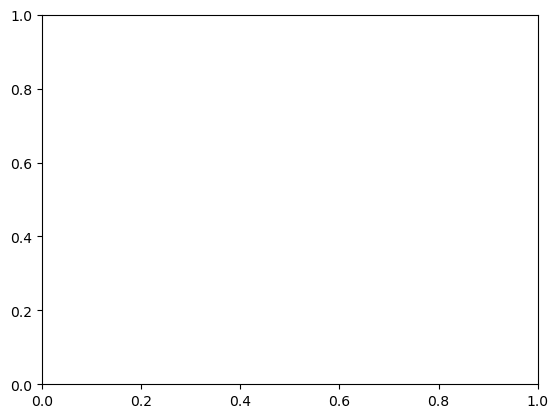

In [8]:
data = xr.open_zarr("gs://weatherbench2/datasets/ifs_extended_range/weekly/ifs-ext-reforecast-full-single-level-weekly_avg.zarr")
data = data["2m_temperature"].isel(prediction_timedelta=0).mean(dim="number")
years = data.groupby(data.time.dt.year).mean().year.values
print(years)
temp = data.groupby(data.time.dt.year).mean().values

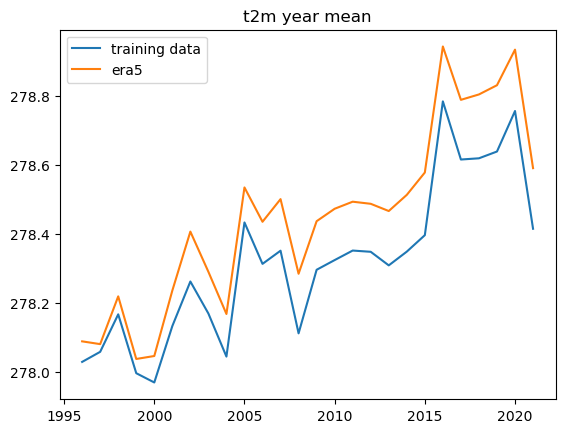

In [16]:
plt.plot(years, temp.mean(axis=(0,1)), label="training data")
plt.plot(years, temp_year.mean(axis=(1,2))[:-2], label="era5")

plt.legend()
plt.title("t2m year mean")
plt.show()

Text(0.5, 1.0, 't2m year mean difference train -true ')

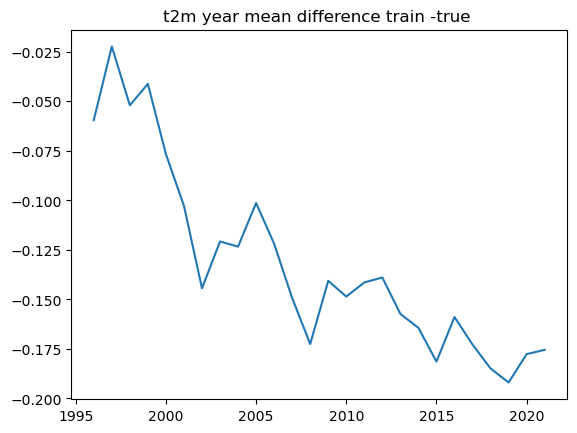

In [38]:
plt.plot(years, temp.mean(axis=(0,1))- temp_year.mean(axis=(1,2))[:-2], label="diff")
plt.title("t2m year mean difference train -true ")

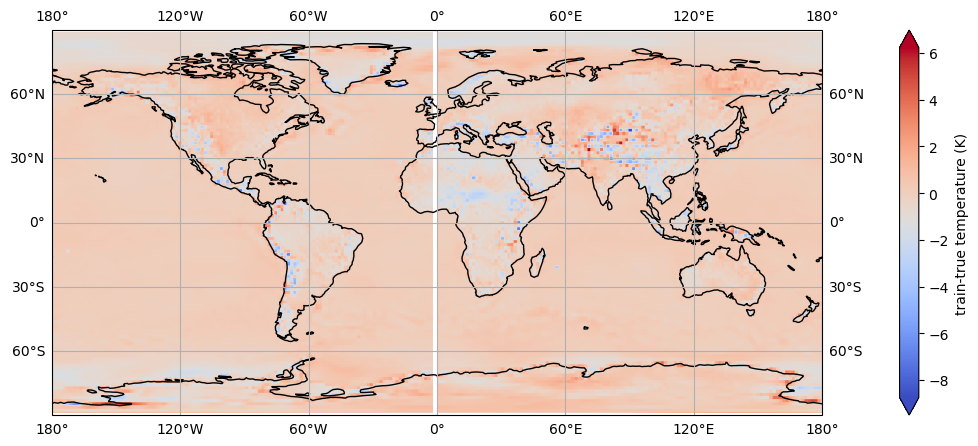

In [33]:
plot_map(test_dataset.latitude, test_dataset.longitude, temp[:,:,0]-temp_year[0,:,:].T, "train-true temperature (K)", cmap="coolwarm")

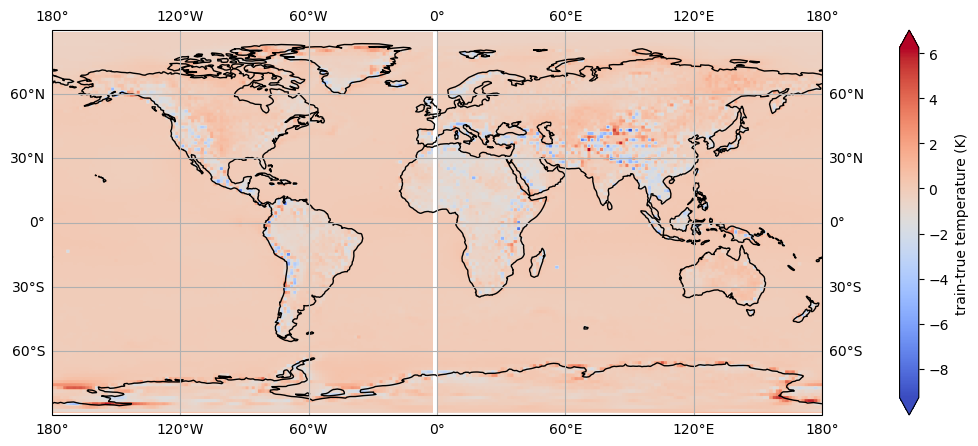

In [34]:
plot_map(test_dataset.latitude, test_dataset.longitude, temp.mean(axis=2)-temp_year[:-2,:,:].mean(axis=0).T, "train-true temperature (K)", cmap="coolwarm")

In [ ]:
years = obs["2m_temperature"].groupby(obs.time.dt.year).mean().year.values
temp_year = obs["2m_temperature"].groupby(obs.time.dt.year).mean().values 
print(temp_year.shape)
plt.plot(years[:-1],temp_year.mean(axis=(1,2))[:-1])
plt.title("year average t2m over the years, era5")
plt.show()

In [119]:
dt = obs[["2m_temperature", "10m_wind_speed"]].isel(time=0).to_array().values
# change dim
dt = dt.transpose(0,2,1)
dt.shape

(2, 121, 240)

In [93]:
mtrain["2m_temperature"].values.shape

(20, 7, 121, 240)

In [3]:
for k in range(1996,2018):
    print((k-1996)/(2017-1996))

0.0
0.047619047619047616
0.09523809523809523
0.14285714285714285
0.19047619047619047
0.23809523809523808
0.2857142857142857
0.3333333333333333
0.38095238095238093
0.42857142857142855
0.47619047619047616
0.5238095238095238
0.5714285714285714
0.6190476190476191
0.6666666666666666
0.7142857142857143
0.7619047619047619
0.8095238095238095
0.8571428571428571
0.9047619047619048
0.9523809523809523
1.0


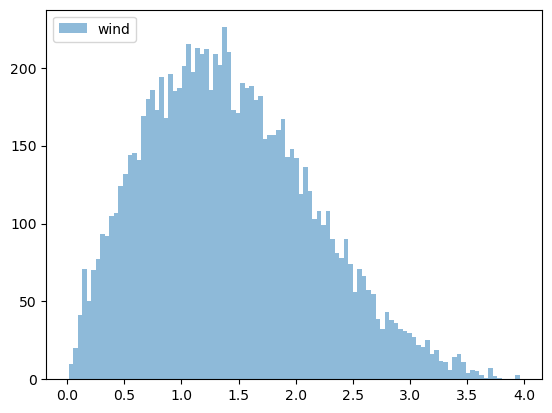

In [104]:
# hypothese de normalité
plt.hist(obs["10m_wind_speed"].values[:,84,101], bins=100, alpha=0.5, label="wind")
plt.legend(loc='upper left')
plt.show()

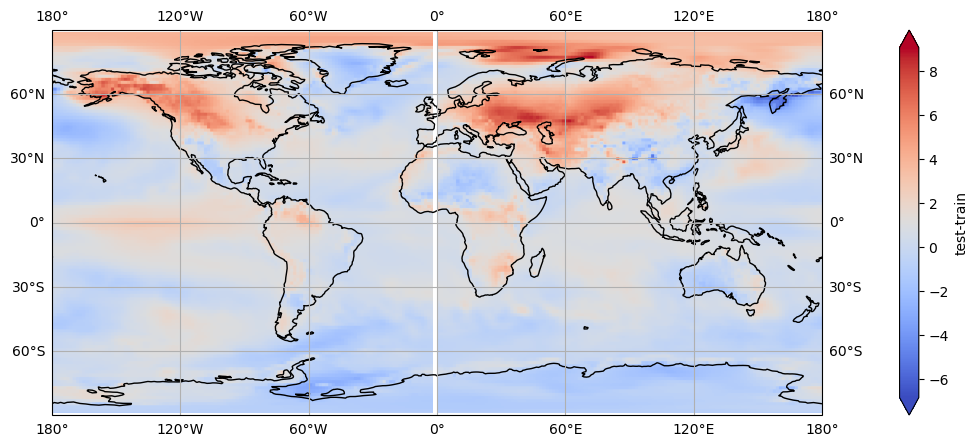

In [34]:
plot_map(test_dataset.latitude, test_dataset.longitude,(testing-training).mean(axis=0), "test-train", cmap="coolwarm")

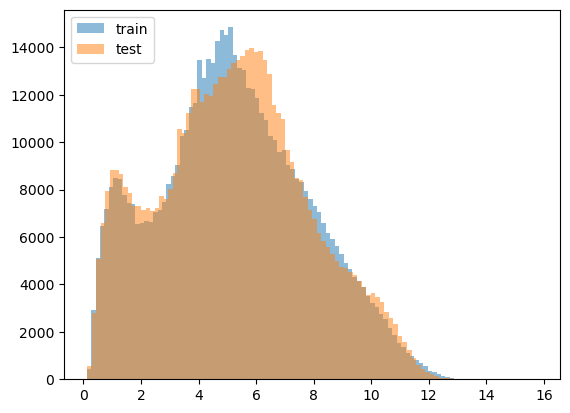

In [41]:
### histogram 
lead_time =2
training = mtrain["10m_wind_speed"].isel(prediction_timedelta=lead_time).values
testing = mtest["10m_wind_speed"].isel(prediction_timedelta=lead_time).values
observed = obs["10m_wind_speed"].isel(time=valid_time).values
plt.hist(training.flatten(), bins=100, alpha=0.5, label='train')
plt.hist(testing.flatten(), bins=100, alpha=0.5, label='test')
plt.legend(loc='upper left')
plt.show()

In [13]:
# compute scaling ground truth
truth = obs[["2m_temperature", "10m_wind_speed"]]
truth

# compute mean and std of the obs data within specific years
years = [1996,2017]
truth = truth.sel(time=slice(f"{years[0]}-01-01", f"{years[1]}-12-31"))

<xarray.Dataset>
Dimensions:         (time: 9863, longitude: 240, latitude: 121)
Coordinates:
  * latitude        (latitude) float64 -90.0 -88.5 -87.0 ... 87.0 88.5 90.0
  * longitude       (longitude) float64 0.0 1.5 3.0 4.5 ... 355.5 357.0 358.5
  * time            (time) datetime64[ns] 1996-01-04 1996-01-05 ... 2023-01-04
Data variables:
    2m_temperature  (time, longitude, latitude) float32 dask.array<chunksize=(9863, 240, 121), meta=np.ndarray>
    10m_wind_speed  (time, longitude, latitude) float32 dask.array<chunksize=(9863, 240, 121), meta=np.ndarray>

## 2. Tables 
### Regional CRPSS

- `month_table`: colums regional CRPSS (global, ocean, land, 90-30N, 30N-30S, 30-90S land), rows month. One table per lead time 

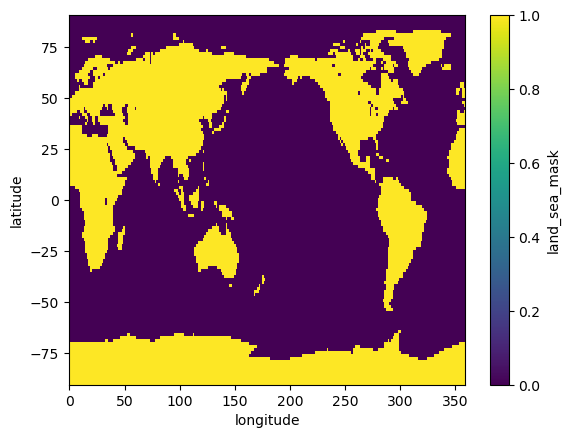

In [7]:
obs_folder = "/home/majanvie/scratch/data/raw/obs"
land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.T # (lat, lon)
land_sea_mask = land_sea_mask > 0.5

land_sea_mask.plot()

In [11]:
def month_table(lead_time, cutoff_mask=0.5, weighted=False):
    base_dir = f"training_results/spatial_month/lead{lead_time}"    
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
    land_sea_mask = land_sea_mask > cutoff_mask

    table = []
    for variable in ["2m_temperature", "10m_wind_speed"]:
        if variable == "2m_temperature":
            train_index = 1
            epoch = 9
            name_var = variable[3:]
        else:
            train_index = 2
            epoch = 14
            name_var = variable[4:]

        for month in range(1,13):
            # get month data 
            file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}/crps_{epoch}.nc"
            train_index += 2
            eval_data = xr.open_dataset(file_path)              
            crps = eval_data[f"crps_{name_var}"].mean(axis=0)
            crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)

            crpss = compute_crpss(crps, crps_clim)
            crpss_land = crpss * land_sea_mask
            crpss_sea = crpss * (1 - land_sea_mask)
            #print(land_sea_mask[0], (1-land_sea_mask)[0])
            shift_idx_lat = 90
            table.append({
                "month": month,
                "variable": variable,
                "crps": crps.mean().item(),
                "mean": crpss.mean().item(),
                "std": crpss.std().item(),
                "land": crpss_land.mean().item(),
                "sea": crpss_sea.mean().item(),
                "90-30N": crpss_land.sel(latitude=slice(30, 90)).mean().item(),  
                "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).mean().item(), 
                "90-30S": crpss_land.sel(latitude=slice(-90, -30)).mean().item()
            })

    return pd.DataFrame(table)

def year_table(leads):
    table = []
    for lead in leads:
        m_table = month_table(lead)
        year_table = m_table.groupby('variable').mean().reset_index()
        year_table['lead'] = lead
        table.append(year_table)
    return pd.concat(table)
            

In [85]:
table28 = month_table(28)
table28

,month,variable,crps,mean,std,land,sea,90-30N,30S-30N,90-30S
0,1,2m_temperature,1.744179,-1.299325,1.557068,-0.167743,-1.131582,-0.075394,-0.252643,-0.175009
1,2,2m_temperature,1.836473,-1.248464,1.708686,-0.132535,-1.115930,-0.023058,-0.296062,-0.079803
2,3,2m_temperature,1.686260,-1.153084,1.645749,-0.093966,-1.059118,-0.022833,-0.235744,-0.025042
3,4,2m_temperature,1.610667,-1.185999,1.642001,-0.120119,-1.065880,-0.050409,-0.266193,-0.045619
4,5,2m_temperature,1.547881,-1.103927,1.554069,-0.109366,-0.994562,-0.056970,-0.261826,-0.011742
5,6,2m_temperature,1.587867,-1.579166,1.918116,-0.150220,-1.428946,-0.098966,-0.315473,-0.039003
6,7,2m_temperature,1.537071,-1.668849,2.318767,-0.176480,-1.492368,-0.141877,-0.351315,-0.039670
7,8,2m_temperature,1.547888,-1.399822,1.765937,-0.165914,-1.233908,-0.117800,-0.342908,-0.040178
8,9,2m_temperature,1.543907,-1.302218,1.776487,-0.172382,-1.129836,-0.086576,-0.379470,-0.054058
9,10,2m_temperature,1.567514,-1.156300,1.658653,-0.131932,-1.024368,-0.049346,-0.292068,-0.056273


In [80]:
# 14 epochs t2m 
base_dir = f"training_results/spatial_month/train0"    
obs_folder = "/home/majanvie/scratch/data/raw/obs"
land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
land_sea_mask = land_sea_mask > 0.5
lead_time = 28

table = []
for variable in ["2m_temperature", "10m_wind_speed"]:
    if variable == "2m_temperature":
        train_index = 2
        epoch = 14
        name_var = variable[3:]
    else:
        train_index = 3
        epoch = 14
        name_var = variable[4:]

    for month in range(1,13):
        # get month data 
        file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}/crps_{epoch}.nc"
        train_index += 2
        eval_data = xr.open_dataset(file_path)                
        crps = eval_data[f"crps_{name_var}"].mean(axis=0)
        crps_clim = eval_data[f"crps_{name_var}_climato"].mean(axis=0)

        crpss = compute_crpss(crps, crps_clim)
        crpss_land = crpss * land_sea_mask
        crpss_sea = crpss * (1 - land_sea_mask)
        #print(land_sea_mask[0], (1-land_sea_mask)[0])
        shift_idx_lat = 90
        table.append({
            "month": month,
            "variable": variable,
            "crps": crps.mean().item(),
            "mean": crpss.mean().item(),
            "std": crpss.std().item(),
            "land": crpss_land.mean().item(),
            "sea": crpss_sea.mean().item(),
            "90-30N": crpss_land.sel(latitude=slice(30, 90)).mean().item(),  
            "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).mean().item(), 
            "90-30S": crpss_land.sel(latitude=slice(-90, -30)).mean().item()
        })

table = pd.DataFrame(table)
table

            

,month,variable,crps,mean,std,land,sea,90-30N,30S-30N,90-30S
0,1,2m_temperature,1.771020,-1.435116,1.853826,-0.177780,-1.257336,-0.063764,-0.303647,-0.166218
1,2,2m_temperature,2.170393,-1.547912,2.062417,-0.198811,-1.349101,-0.097138,-0.383684,-0.117641
2,3,2m_temperature,1.774074,-1.306134,1.876678,-0.134991,-1.171143,-0.055337,-0.316640,-0.035485
3,4,2m_temperature,1.696697,-1.379500,1.968827,-0.144427,-1.235073,-0.050004,-0.327381,-0.058057
4,5,2m_temperature,1.659553,-1.312366,1.836819,-0.141582,-1.170784,-0.090564,-0.320675,-0.016632
5,6,2m_temperature,1.724010,-1.877852,2.348775,-0.182141,-1.695711,-0.142885,-0.354725,-0.052066
6,7,2m_temperature,1.649492,-1.946935,2.669799,-0.210652,-1.736283,-0.171128,-0.405392,-0.059222
7,8,2m_temperature,1.638499,-1.585409,1.939587,-0.194299,-1.391110,-0.182092,-0.380942,-0.024116
8,9,2m_temperature,1.690764,-1.529693,2.138433,-0.228113,-1.301580,-0.168307,-0.432380,-0.087175
9,10,2m_temperature,1.657204,-1.362453,1.948137,-0.158859,-1.203594,-0.051141,-0.360869,-0.066866


In [5]:
year_crpss = year_table([7,21,28,35,39])
year_crpss

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.813906,0.140875,0.120937,0.035711,0.105165,0.038194,0.035703,0.033295,7
1,2m_temperature,6.5,1.511698,-1.236673,1.747481,-0.094747,-1.141926,0.000336,-0.270210,-0.016328,7
0,10m_wind_speed,6.5,0.921537,0.034187,0.077222,0.006211,0.027977,0.009599,0.006962,0.002173,21
1,2m_temperature,6.5,1.617743,-1.282121,1.730263,-0.133571,-1.148550,-0.066695,-0.289909,-0.046291,21
0,10m_wind_speed,6.5,0.924162,0.030635,0.073923,0.005504,0.025131,0.009126,0.005404,0.002069,28
1,2m_temperature,6.5,1.628790,-1.289801,1.734009,-0.139140,-1.150661,-0.066862,-0.290632,-0.061858,28
0,10m_wind_speed,6.5,0.925802,0.029088,0.070190,0.006076,0.023012,0.009169,0.004590,0.004508,35
1,2m_temperature,6.5,1.618292,-1.275256,1.705192,-0.133828,-1.141427,-0.068211,-0.289087,-0.046374,35
0,10m_wind_speed,6.5,0.927645,0.027572,0.069199,0.006003,0.021569,0.009228,0.004257,0.004561,39
1,2m_temperature,6.5,1.612424,-1.277286,1.720567,-0.133097,-1.144189,-0.071544,-0.287864,-0.042156,39


### Plot performances with respect to lead times 

In [9]:
def plot_lead_evolution(var, y_table, metrics, crpss_type):
    plt.figure(figsize=(10, 5))
    for metric in metrics:
        plt.plot(y_table[y_table.variable == var].lead, y_table[y_table.variable == var][metric], label=metric, marker='o')
    plt.xlabel("Lead time")
    plt.ylabel(f"CRPSS of {crpss_type}")
    plt.title(f"Evolution of {var} CRPSS with lead time")
    plt.legend()

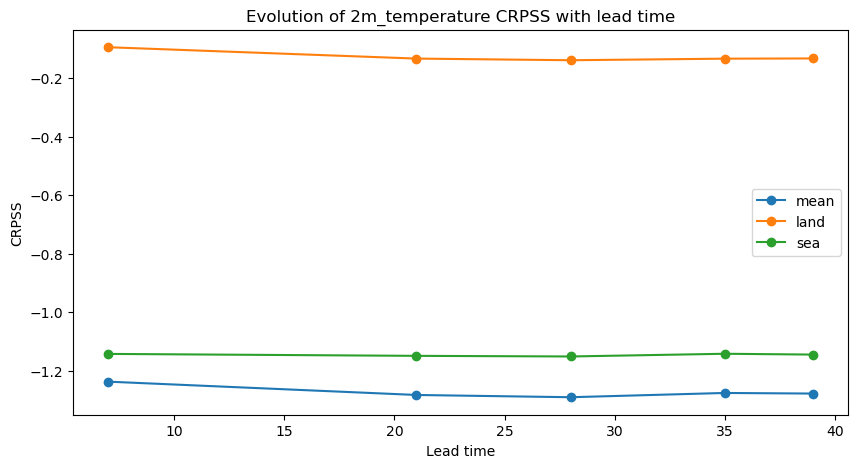

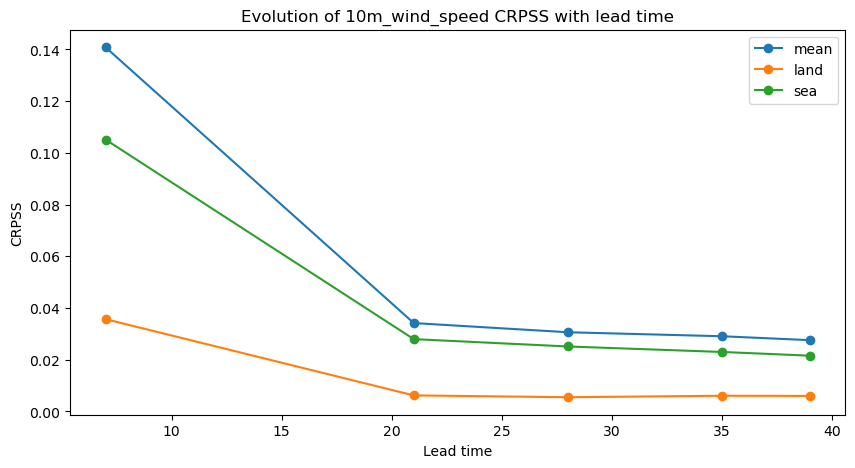

In [72]:
plot_lead_evolution("2m_temperature", year_crpss,['mean', 'land', 'sea'])
plot_lead_evolution("10m_wind_speed", year_crpss,['mean', 'land', 'sea'])

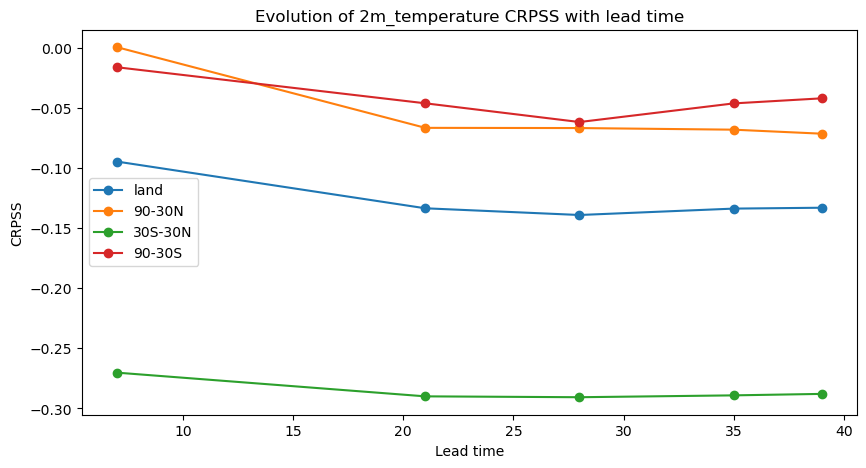

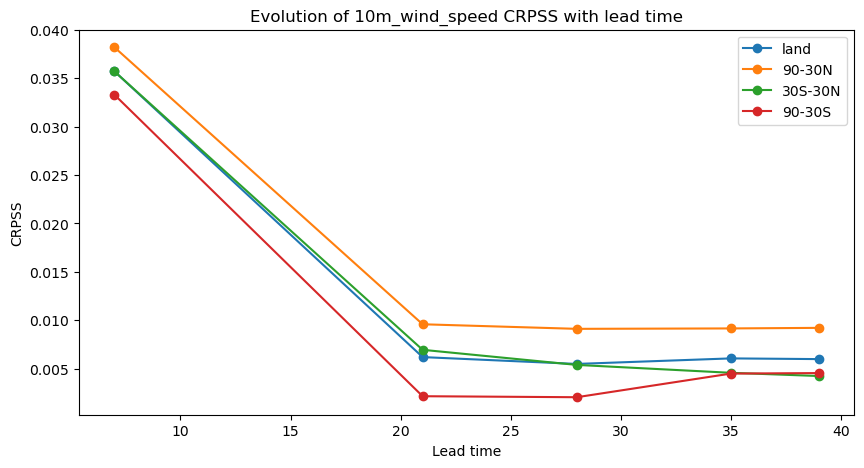

In [67]:
plot_lead_evolution("2m_temperature", year_crpss,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution("10m_wind_speed", year_crpss,['land','90-30N', '30S-30N', '90-30S'])

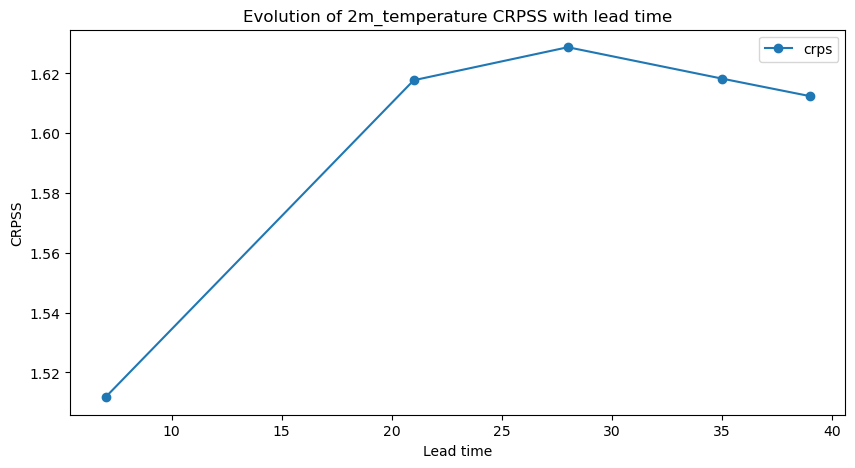

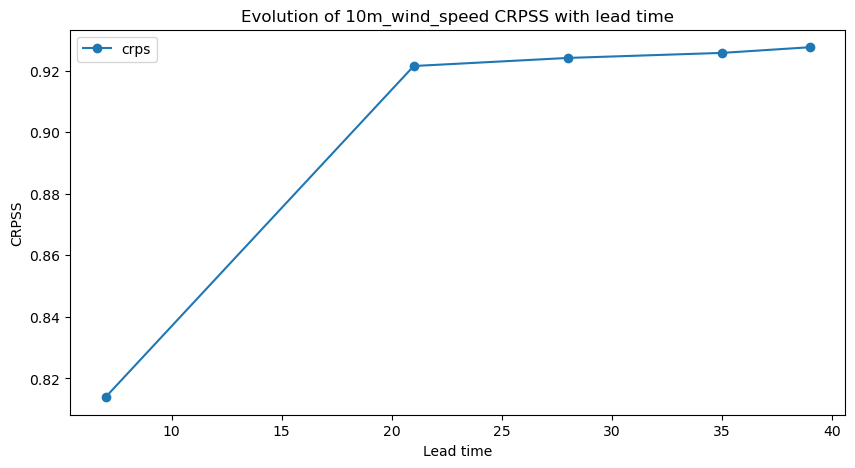

In [9]:
plot_lead_evolution("2m_temperature", year_crpss,["crps"])
plot_lead_evolution("10m_wind_speed", year_crpss,["crps"])

### Weight with latitude 
Calculating the cosine of latitude as weights for gridded data

In [4]:
def month_table_weight(lead_time, exp_name, cutoff_mask=0.5):
    if "spatial" in exp_name: # spatial_month or spatial_month_ensemble
        base_dir = f"training_results/{exp_name}/lead{lead_time}"   
    elif "raw" in exp_name:
        base_dir = f"/home/majanvie/scratch/data/test/EMOS/crps/lead{lead_time}"


    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
    land_sea_mask = land_sea_mask > cutoff_mask

    table = []
    for variable in ["2m_temperature", "10m_wind_speed"]:
        if variable == "2m_temperature":
            train_index = 1
            epoch = 9
            name_var = variable[3:]
        else:
            train_index = 2
            epoch = 14
            name_var = variable[4:]

        for month in range(1,13):
            # get month data 
            if "spatial" in exp_name:
                file_path = f"{base_dir}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}/crps_{epoch}.nc"
            elif "raw" in exp_name:
                file_path = f"{base_dir}/crps_month{month}_{variable}.nc"
            train_index += 2
            eval_data = xr.open_dataset(file_path) 

            # cos weights for latitude
            lats = eval_data.latitude
            weights = np.cos(np.deg2rad(lats))

            crps = eval_data[f"crps_{name_var}"].weighted(weights).mean(dim='time')
            crps_clim = eval_data[f"crps_{name_var}_climato"].weighted(weights).mean(dim='time')
            crpss = compute_crpss(crps, crps_clim)

            crpss_land = crpss * land_sea_mask
            crpss_sea = crpss * (1 - land_sea_mask)

            table.append({
                "month": month,
                "variable": variable,
                "crps": crps.weighted(weights).mean().item(),
                "mean": crpss.weighted(weights).mean().item(),
                "std": crpss.weighted(weights).std().item(),
                "land": crpss_land.weighted(weights).mean().item(),
                "sea": crpss_sea.weighted(weights).mean().item(),
                "90-30N": crpss_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
                "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
                "90-30S": crpss_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
            })

    return pd.DataFrame(table)


def year_table_weight(leads, exp_name):
    table = []
    for lead in leads:
        m_table = month_table_weight(lead,exp_name)
        year_table = m_table.groupby('variable').mean().reset_index()
        year_table['lead'] = lead
        table.append(year_table)
    return pd.concat(table)         

In [134]:
def month_table_weight_model(lead_time, exp_name, cutoff_mask=0.5):
    # CRPSS of post-processed and raw model vs climato
    base_dir_post = f"training_results/{exp_name}/lead{lead_time}"   
    base_dir_raw = f"/home/majanvie/scratch/data/test/EMOS/crps/lead{lead_time}"

    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
    land_sea_mask = land_sea_mask > cutoff_mask

    table = []
    table_clim = []
    for variable in ["2m_temperature", "10m_wind_speed"]:
        if variable == "2m_temperature":
            train_index = 1
            epoch = 9
            name_var = variable[3:]
        else:
            train_index = 2
            epoch = 14
            name_var = variable[4:]

        for month in range(1,13):
            # get month data 
            file_path_post = f"{base_dir_post}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}/crps_{epoch}.nc"
            file_path_raw = f"{base_dir_raw}/crps_month{month}_{variable}.nc"
            train_index += 2
            eval_data_post = xr.open_dataset(file_path_post)
            eval_data_raw = xr.open_dataset(file_path_raw) 

            # cos weights for latitude
            lats = eval_data_post.latitude
            weights = np.cos(np.deg2rad(lats))

            crps_post = eval_data_post[f"crps_{name_var}"].weighted(weights).mean(dim='time')
            crps_raw = eval_data_raw[f"crps_{name_var}"].weighted(weights).mean(dim='time')
            crps_clim = eval_data_post[f"crps_{name_var}_climato"].weighted(weights).mean(dim='time')
            crpss = compute_crpss(crps_post, crps_clim)

            crpss_land = crpss * land_sea_mask
            crpss_sea = crpss * (1 - land_sea_mask)
            crps_land = crps_post * land_sea_mask

            table.append({
                "month": month,
                "variable": variable,
                "crps_land": crps_land.weighted(weights).mean().item(),
                #"mean": crpss.weighted(weights).mean().item(),
                #"std": crpss.weighted(weights).std().item(),
                "land": crpss_land.weighted(weights).mean().item(),
                #"sea": crpss_sea.weighted(weights).mean().item(),
                "90-30N": crpss_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
                "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
                "90-30S": crpss_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
            })

            # climato vs raw
            
            crpss_raw = compute_crpss(crps_raw, crps_clim)
            crpss_r_land = crpss_raw * land_sea_mask
            crpss_r_sea = crpss_raw * (1 - land_sea_mask)

            crps_land_raw = crps_raw * land_sea_mask

            table_clim.append({
                "month": month,
                "variable": variable,
                "crps_land": crps_land_raw.weighted(weights).mean().item(),
                #"mean": crpss_raw.weighted(weights).mean().item(),
                #"std": crpss_raw.weighted(weights).std().item(),
                "land": crpss_r_land.weighted(weights).mean().item(),
                #"sea": crpss_r_sea.weighted(weights).mean().item(),
                "90-30N": crpss_r_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
                "30S-30N": crpss_r_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
                "90-30S": crpss_r_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
            })

    return pd.DataFrame(table), pd.DataFrame(table_clim)


def year_table_weight_model(leads, exp_name):
    table = []
    table_clim = []
    for lead in leads:
        m_table, m_table_clim = month_table_weight_model(lead,exp_name)
        year_table = m_table.groupby('variable').mean().reset_index()
        year_table_clim = m_table_clim.groupby('variable').mean().reset_index()
        year_table['lead'] = lead
        year_table_clim['lead'] = lead
        table.append(year_table)
        table_clim.append(year_table_clim)
    return pd.concat(table), pd.concat(table_clim)        

In [118]:
month_table_weight_model(14, "spatial_month_ensemble")

(    month        variable      crps      mean       std      land       sea  \
 0       1  2m_temperature  1.865457 -2.500129  3.113426 -0.240706 -2.259423   
 1       2  2m_temperature  2.053547 -2.587268  3.239021 -0.315744 -2.271524   
 2       3  2m_temperature  1.831183 -2.543665  3.272777 -0.248907 -2.294758   
 3       4  2m_temperature  1.814025 -2.651250  3.548885 -0.280649 -2.370601   
 4       5  2m_temperature  1.794389 -2.546497  3.187950 -0.283506 -2.262991   
 5       6  2m_temperature  1.807765 -2.792674  3.390441 -0.320037 -2.472637   
 6       7  2m_temperature  1.805637 -2.922282  3.799588 -0.380786 -2.541496   
 7       8  2m_temperature  1.780369 -2.894628  3.840896 -0.368958 -2.525671   
 8       9  2m_temperature  1.834851 -2.931924  3.810807 -0.370973 -2.560950   
 9      10  2m_temperature  1.796585 -2.664497  3.418773 -0.296573 -2.367924   
 10     11  2m_temperature  1.848852 -2.538355  3.454299 -0.257808 -2.280547   
 11     12  2m_temperature  1.853357 -2.

In [135]:
y_model, y_model_raw = year_table_weight_model([7,14,21,28,35,39], "spatial_month_ensemble")
y_model

,variable,month,crps_land,land,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.124083,0.032743,0.044649,0.035467,0.016039,7
1,2m_temperature,6.5,0.557872,-0.277354,-0.106027,-0.484559,-0.035862,7
0,10m_wind_speed,6.5,0.136196,0.010479,0.013458,0.012355,0.003962,14
1,2m_temperature,6.5,0.612282,-0.303025,-0.171360,-0.490664,-0.061894,14
0,10m_wind_speed,6.5,0.138689,0.005765,0.008485,0.006092,0.002527,21
1,2m_temperature,6.5,0.628262,-0.308190,-0.189972,-0.492507,-0.060705,21
0,10m_wind_speed,6.5,0.139089,0.004671,0.008874,0.003993,0.001981,28
1,2m_temperature,6.5,0.633790,-0.313126,-0.197931,-0.497211,-0.063203,28
0,10m_wind_speed,6.5,0.139254,0.004376,0.008204,0.003376,0.002673,35
1,2m_temperature,6.5,0.623305,-0.304444,-0.191393,-0.488100,-0.053316,35


In [120]:
y_model_raw

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.935916,-0.141467,0.690239,-0.097438,-0.044029,-0.103204,-0.138015,-0.012575,7
1,2m_temperature,6.5,0.648860,0.175190,0.869713,-0.068377,0.243567,0.040943,-0.164406,0.014951,7
0,10m_wind_speed,6.5,1.019828,-0.218442,0.661806,-0.111039,-0.107403,-0.127521,-0.148070,-0.022865,14
1,2m_temperature,6.5,0.763652,0.059206,0.666904,-0.083681,0.142887,-0.029126,-0.151982,-0.002244,14
0,10m_wind_speed,6.5,1.046328,-0.245454,0.665510,-0.115975,-0.129479,-0.135823,-0.153068,-0.024467,21
1,2m_temperature,6.5,0.806574,0.009030,0.641122,-0.092796,0.101826,-0.053219,-0.156022,-0.006969,21
0,10m_wind_speed,6.5,1.051847,-0.250516,0.664275,-0.116795,-0.133721,-0.137332,-0.154060,-0.024289,28
1,2m_temperature,6.5,0.825732,-0.015642,0.633944,-0.095174,0.079532,-0.064205,-0.155077,-0.007622,28
0,10m_wind_speed,6.5,1.053296,-0.251170,0.662555,-0.116961,-0.134209,-0.137658,-0.154432,-0.023900,35
1,2m_temperature,6.5,0.836501,-0.032049,0.629980,-0.095657,0.063607,-0.070096,-0.153080,-0.007784,35


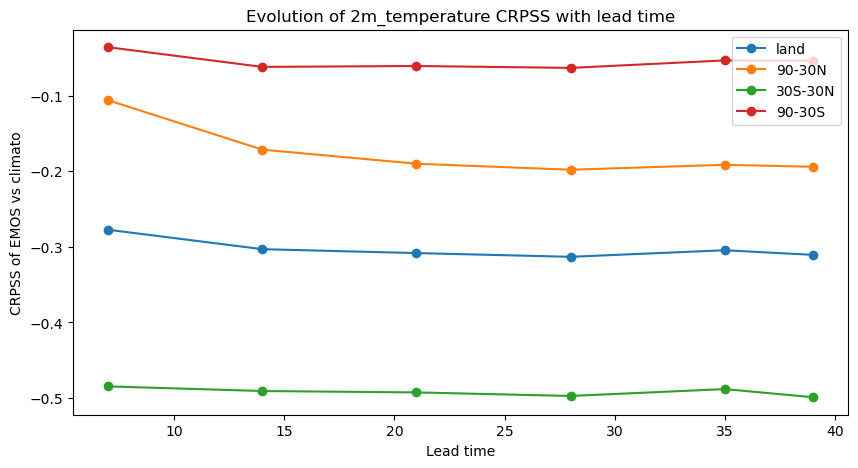

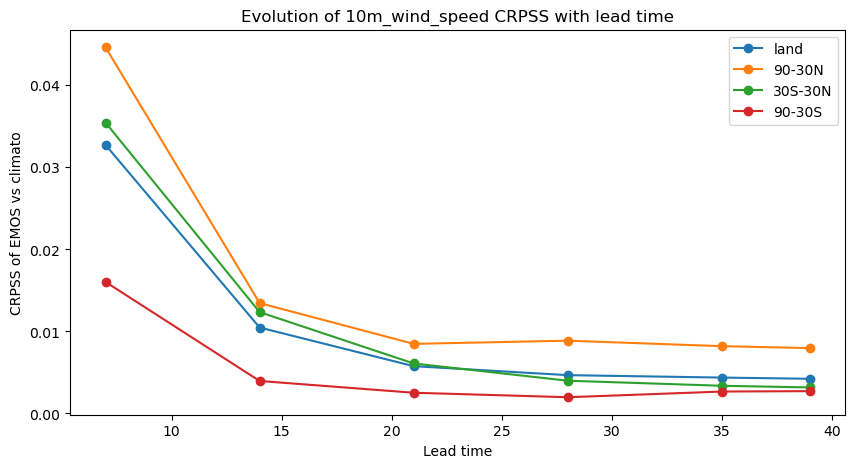

In [122]:
plot_lead_evolution("2m_temperature", y_model,['land','90-30N', '30S-30N', '90-30S'], "EMOS vs climato")
plot_lead_evolution("10m_wind_speed", y_model,['land','90-30N', '30S-30N', '90-30S'], "EMOS vs climato")


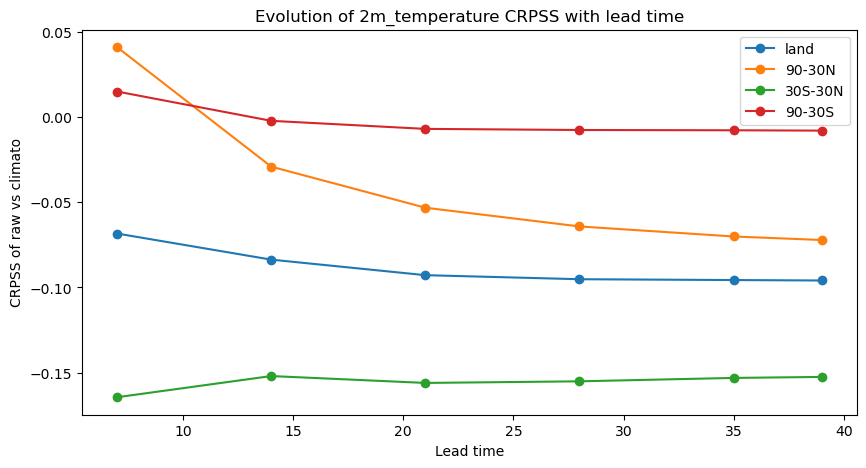

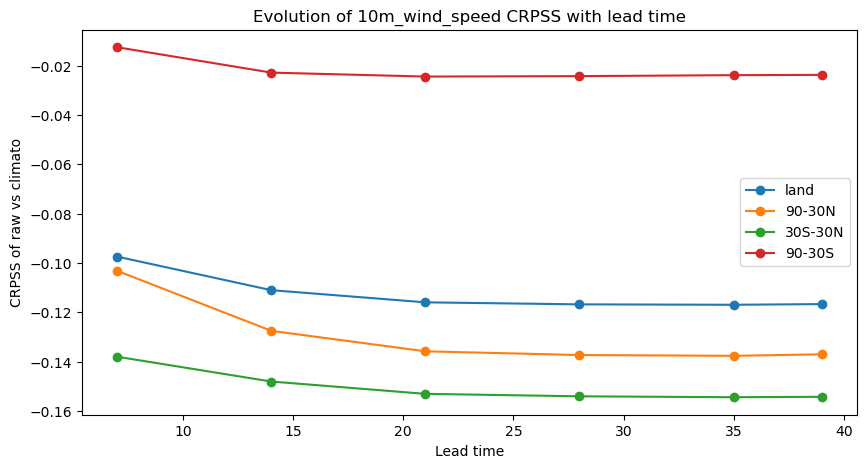

In [124]:
plot_lead_evolution("2m_temperature", y_model_raw,['land','90-30N', '30S-30N', '90-30S'], "raw vs climato")
plot_lead_evolution("10m_wind_speed", y_model_raw,['land', '90-30N', '30S-30N', '90-30S'], "raw vs climato")


In [8]:
y_table_w = year_table_weight([7,21,28,35,39], "spatial_month")
y_table_w

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.756071,0.166612,0.128516,0.033089,0.133522,0.046314,0.035530,0.015677,7
1,2m_temperature,6.5,1.344766,-1.596036,1.850410,-0.144082,-1.451954,-0.007069,-0.275605,-0.017804,7
0,10m_wind_speed,6.5,0.877174,0.041431,0.084833,0.006798,0.034634,0.011179,0.006922,0.002368,21
1,2m_temperature,6.5,1.421196,-1.641093,1.848261,-0.177066,-1.464026,-0.088605,-0.294700,-0.031553,21
0,10m_wind_speed,6.5,0.881329,0.035998,0.081230,0.005844,0.030154,0.010698,0.005348,0.002175,28
1,2m_temperature,6.5,1.426998,-1.644616,1.845806,-0.178919,-1.465697,-0.090059,-0.295434,-0.035975,28
0,10m_wind_speed,6.5,0.884511,0.032454,0.077603,0.005565,0.026890,0.010581,0.004516,0.002821,35
1,2m_temperature,6.5,1.420534,-1.632506,1.814852,-0.176992,-1.455515,-0.090181,-0.293867,-0.031384,35
0,10m_wind_speed,6.5,0.886244,0.030616,0.076190,0.005402,0.025215,0.010528,0.004189,0.002874,39
1,2m_temperature,6.5,1.422331,-1.636251,1.827308,-0.176798,-1.459453,-0.093331,-0.292633,-0.030029,39


In [10]:
#year_table([7,21,28,35,39])

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.813906,0.140875,0.120937,0.035711,0.105165,0.038194,0.035703,0.033295,7
1,2m_temperature,6.5,1.511698,-1.236673,1.747481,-0.094747,-1.141926,0.000336,-0.270210,-0.016328,7
0,10m_wind_speed,6.5,0.921537,0.034187,0.077222,0.006211,0.027977,0.009599,0.006962,0.002173,21
1,2m_temperature,6.5,1.617743,-1.282121,1.730263,-0.133571,-1.148550,-0.066695,-0.289909,-0.046291,21
0,10m_wind_speed,6.5,0.924162,0.030635,0.073923,0.005504,0.025131,0.009126,0.005404,0.002069,28
1,2m_temperature,6.5,1.628790,-1.289801,1.734009,-0.139140,-1.150661,-0.066862,-0.290632,-0.061858,28
0,10m_wind_speed,6.5,0.925802,0.029088,0.070190,0.006076,0.023012,0.009169,0.004590,0.004508,35
1,2m_temperature,6.5,1.618292,-1.275256,1.705192,-0.133828,-1.141427,-0.068211,-0.289087,-0.046374,35
0,10m_wind_speed,6.5,0.927645,0.027572,0.069199,0.006003,0.021569,0.009228,0.004257,0.004561,39
1,2m_temperature,6.5,1.612424,-1.277286,1.720567,-0.133097,-1.144189,-0.071544,-0.287864,-0.042156,39


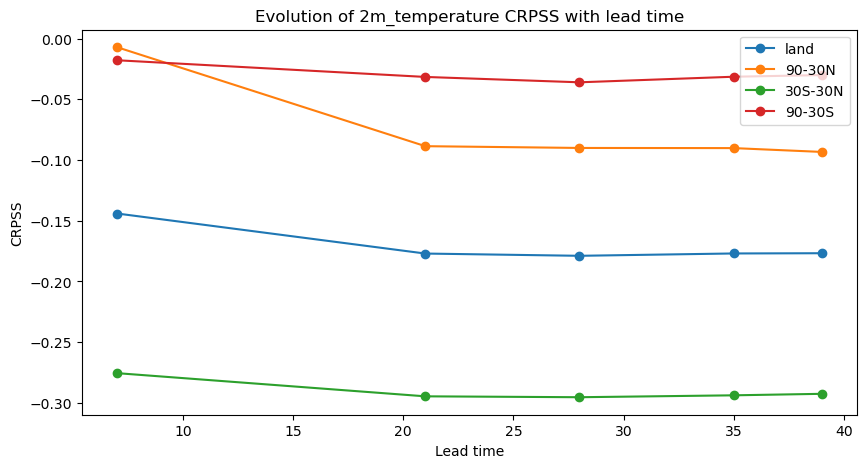

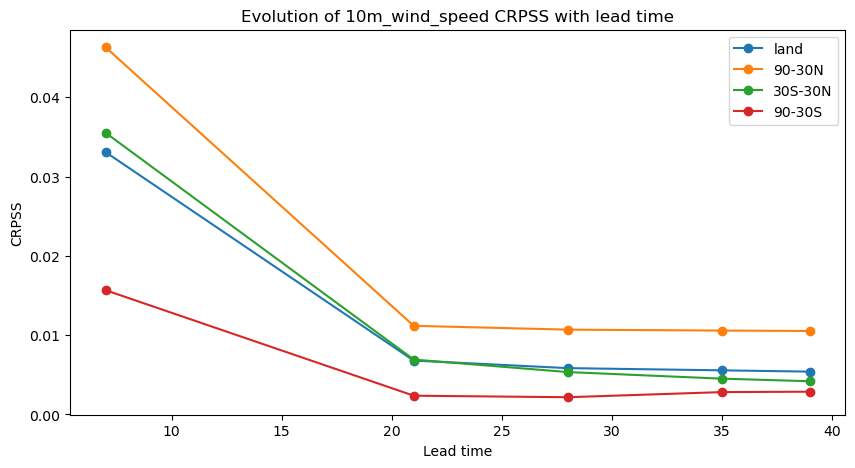

In [15]:
plot_lead_evolution("2m_temperature", y_table_w,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution("10m_wind_speed", y_table_w,['land','90-30N', '30S-30N', '90-30S'])

In [139]:
def plot_lead_evolution_comparison(y_table, y_table_clim, var, metrics, y_lim):
    fig, ax = plt.subplots(3, 2, figsize=(10, 10))
    plt.suptitle(f"Evolution of {var} CRPSS with lead time")

    # Calculate the global min and max for y-axis limits
    # global_min = min(y_table[y_table.variable == var][metrics].min().min(), 
    #                  y_table_clim[y_table_clim.variable == var][metrics].min().min())
    # global_max = max(y_table[y_table.variable == var][metrics].max().max(), 
    #                  y_table_clim[y_table_clim.variable == var][metrics].max().max())
    # y_lim = (global_min, global_max)

    for i, metric in enumerate(metrics):
        axe = ax[i // 2, i % 2]
        if metric=="crps_land":
            axe.set_ylabel("CRPS")
            colors = ["red","black"]
            axe.legend(["EMOS", "raw"])
        else:
            colors = ["blue","black"]
            axe.set_ylabel("CRPSS vs climato")
        axe.plot(y_table[y_table.variable == var].lead, y_table[y_table.variable == var][metric], label="EMOS", marker='o', color=colors[0]) 
        axe.plot(y_table_clim[y_table_clim.variable == var].lead, y_table_clim[y_table_clim.variable == var][metric], label="raw", marker='o', color=colors[1])
        axe.set_xlabel("Lead time")
        axe.set_title(metric)
        axe.set_ylim(y_lim[0]-0.5, y_lim[1]+0.5)

    # Adjust layout to accommodate the title
    plt.tight_layout(rect=[0, 0, 1, 0.95])  
    
    # Add one legend for all subplots
    handles, labels = axe.get_legend_handles_labels()
    fig.legend(handles, labels, loc='upper left')

    plt.show()


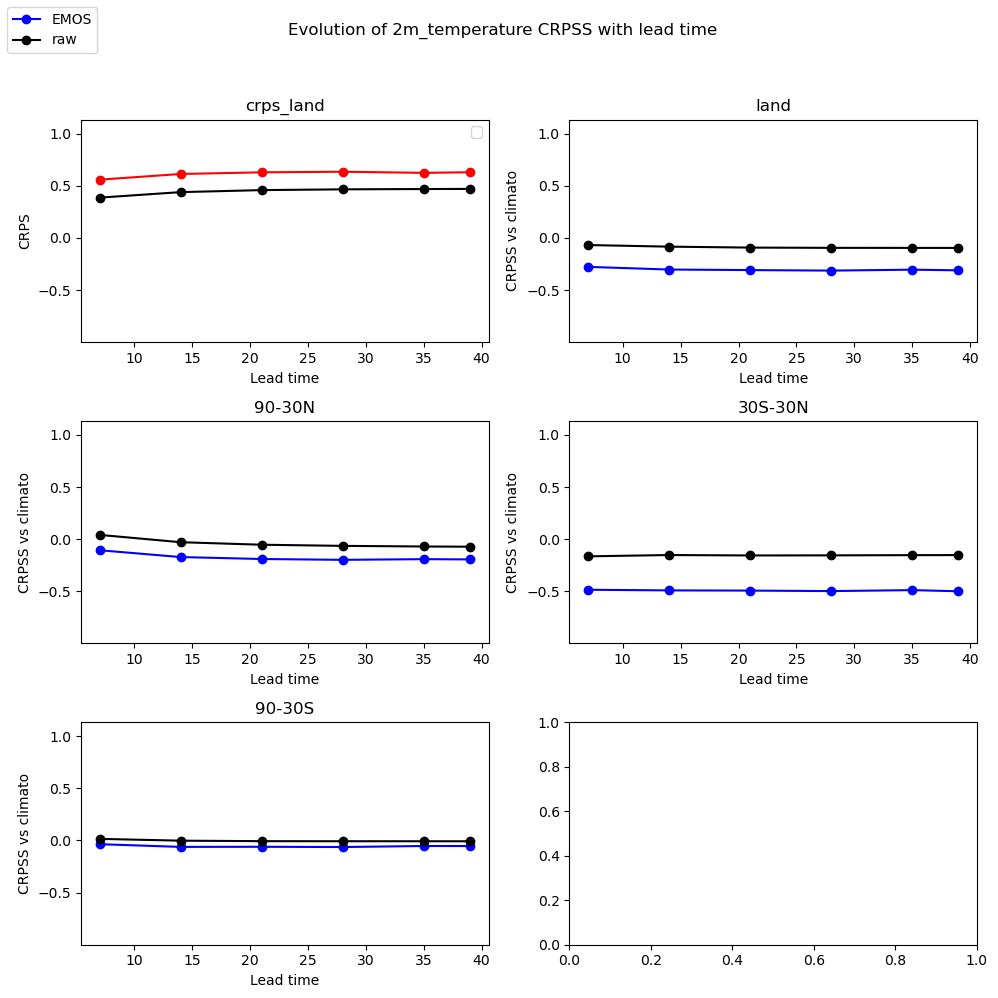

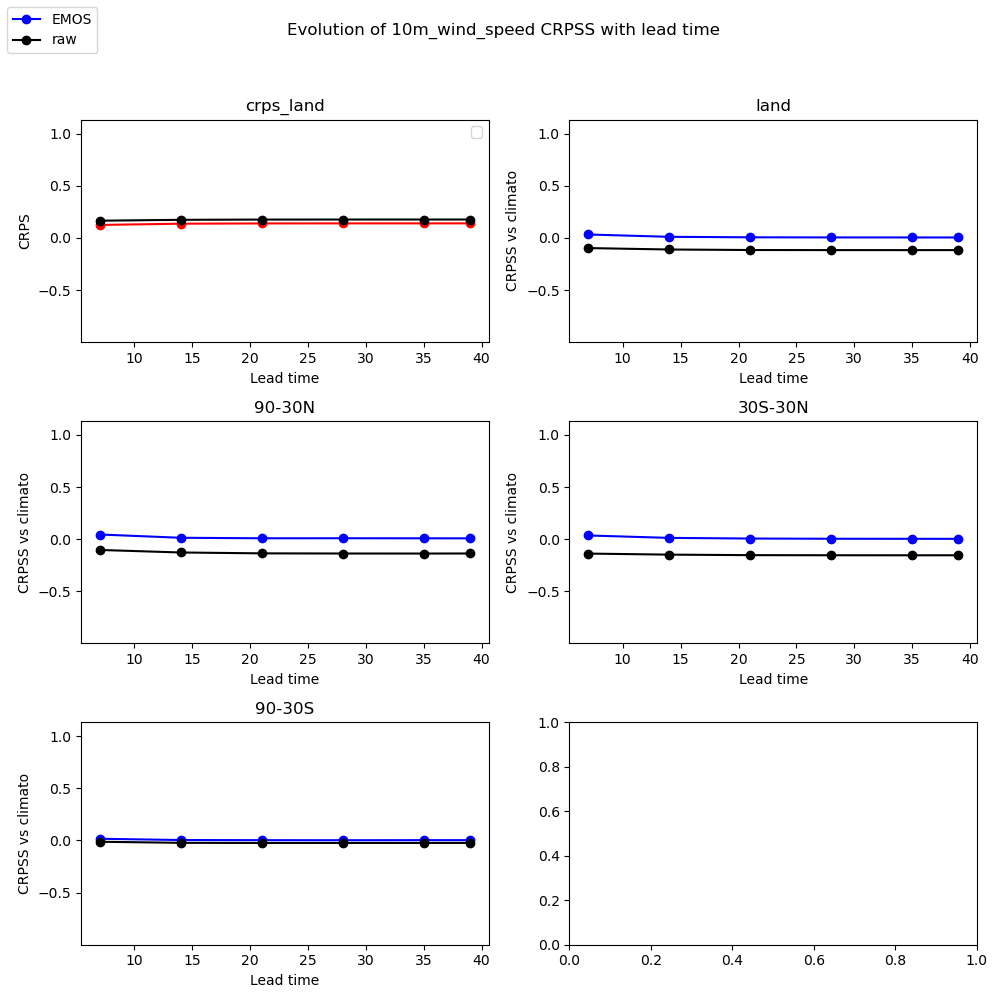

In [140]:
# Calculate the global min and max for y-axis limits
metrics = ['crps_land', 'land', '90-30N', '30S-30N', '90-30S']
global_min = min(y_model[metrics].min().min(), 
                    y_model_raw[metrics].min().min())
global_max = max(y_model[metrics].max().max(), 
                    y_model_raw[metrics].max().max())
lim = [global_min, global_max]
plot_lead_evolution_comparison(y_model, y_model_raw, "2m_temperature", metrics, lim)
plot_lead_evolution_comparison(y_model, y_model_raw, "10m_wind_speed", metrics, lim)

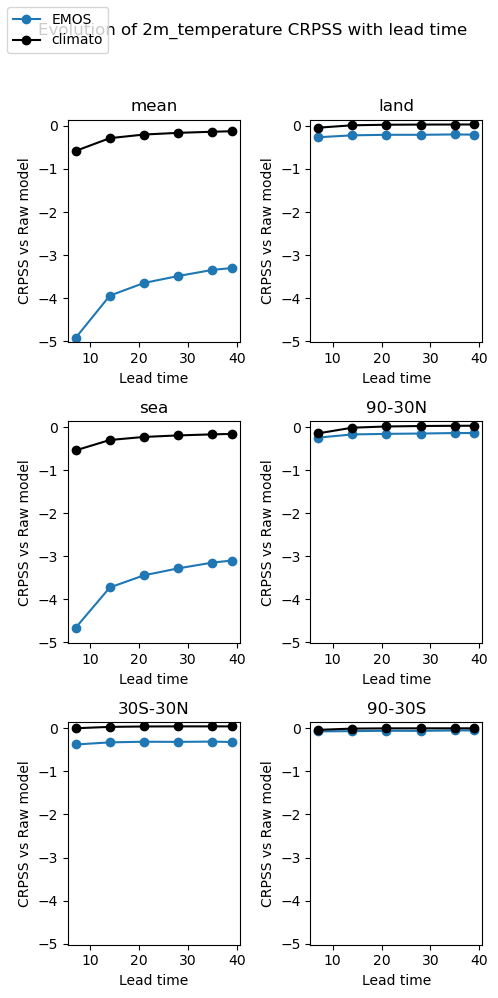

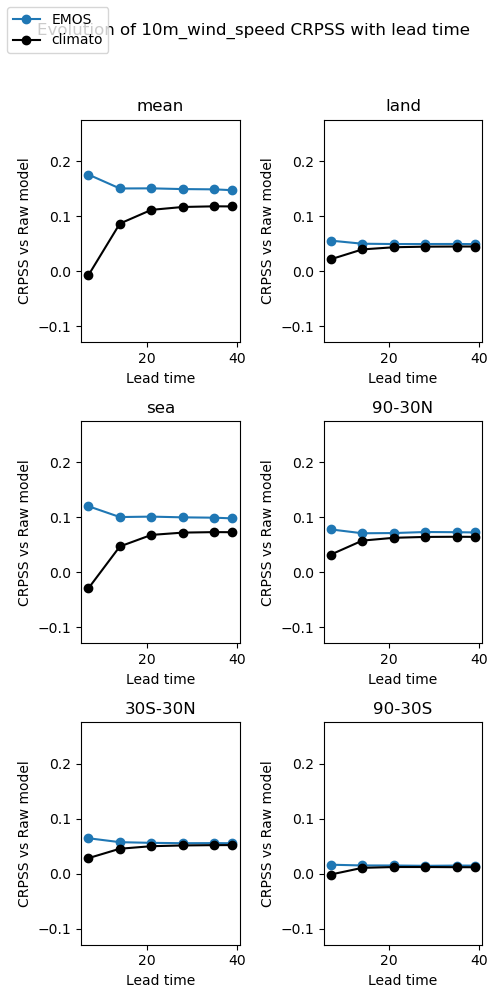

In [48]:
plot_lead_evolution_comparison(y_model, y_model_clim, "2m_temperature", metrics)
plot_lead_evolution_comparison(y_model, y_model_clim, "10m_wind_speed", metrics)

### Temperature investigation

In [33]:
def month_table_weight_temp(lead_time, exp_name, name, train_index, variable, cutoff_mask=0.5):
    # CRPSS of post-processed and raw model vs climato
    base_dir_post = f"training_results/{exp_name}/lead{lead_time}"   
    base_dir_raw = f"/home/majanvie/scratch/data/test/EMOS/crps/lead{lead_time}"

    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
    land_sea_mask = land_sea_mask > cutoff_mask

    table = []
    table_clim = []
    if variable =="2m_temperature":
        epoch = 9
        var = variable[3:]
    else:
        epoch = 14
        var = variable[4:]
    #variable = "10m_wind_speed"
    name_var = "temperature" #variable[3:]
    for month in range(1,2):
        # get month data 
        file_path_post = f"{base_dir_post}/training_{train_index}_spatial_month{month}_{variable}_lead={lead_time}_{name}/crps_{epoch}.nc"
        file_path_raw = f"{base_dir_raw}/crps_month{month}_{variable}.nc"

        eval_data_post = xr.open_dataset(file_path_post)
        eval_data_raw = xr.open_dataset(file_path_raw) 

        # cos weights for latitude
        lats = eval_data_post.latitude
        weights = np.cos(np.deg2rad(lats))

        crps_post = eval_data_post[f"crps_temperature"].weighted(weights).mean(dim='time')
        crps_raw = eval_data_raw[f"crps_{var}"].weighted(weights).mean(dim='time')
        crps_clim = eval_data_raw[f"crps_{var}_climato"].weighted(weights).mean(dim='time')
        crpss = compute_crpss(crps_post, crps_clim)

        crpss_land = crpss * land_sea_mask
        crpss_sea = crpss * (1 - land_sea_mask)
        crps_land = crps_post * land_sea_mask

        table.append({
            "month": month,
            "variable": variable,
            "crps_land": crps_land.weighted(weights).mean().item(),
            #"mean": crpss.weighted(weights).mean().item(),
            #"std": crpss.weighted(weights).std().item(),
            "land": crpss_land.weighted(weights).mean().item(),
            #"sea": crpss_sea.weighted(weights).mean().item(),
            "90-30N": crpss_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
            "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
            "90-30S": crpss_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
        })

        # climato vs raw
        
        crpss_raw = compute_crpss(crps_raw, crps_clim)
        crpss_r_land = crpss_raw * land_sea_mask
        crpss_r_sea = crpss_raw * (1 - land_sea_mask)

        crps_land_raw = crps_raw * land_sea_mask

        table_clim.append({
            "month": month,
            "variable": variable,
            "crps_land": crps_land_raw.weighted(weights).mean().item(),
            #"mean": crpss_raw.weighted(weights).mean().item(),
            #"std": crpss_raw.weighted(weights).std().item(),
            "land": crpss_r_land.weighted(weights).mean().item(),
            #"sea": crpss_r_sea.weighted(weights).mean().item(),
            "90-30N": crpss_r_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
            "30S-30N": crpss_r_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
            "90-30S": crpss_r_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
        })

    return pd.DataFrame(table), pd.DataFrame(table_clim)

      

In [34]:
month_table_weight_temp(14, "spatial_month_ensemble", "prior", 32,"2m_temperature")

(   month        variable  crps_land      land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.698087 -0.292319 -0.148276 -0.476627 -0.06953,
    month        variable  crps_land      land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.483356 -0.063971 -0.013434 -0.115078 -0.01232)

In [35]:
month_table_weight_temp(14, "spatial_month_ensemble", "prior", 33, "10m_wind_speed")

(   month        variable  crps_land      land    90-30N   30S-30N    90-30S
 0      1  10m_wind_speed   0.136476  0.011505  0.014617  0.014077  0.003502,
    month        variable  crps_land      land    90-30N   30S-30N    90-30S
 0      1  10m_wind_speed   0.170453 -0.104243 -0.124557 -0.137416 -0.019956)

In [92]:
f =xr.open_dataset("/home/majanvie/S2S_weather/training_results/spatial_month_ensemble/lead14/training_33_spatial_month1_10m_wind_speed_lead=14_prior/crps_14.nc")
f["crps_temperature"]

<xarray.DataArray 'crps_temperature' (time: 44, latitude: 121, longitude: 240)>
[1277760 values with dtype=float32]
Coordinates:
  * longitude      (longitude) float64 0.0 1.5 3.0 4.5 ... 355.5 357.0 358.5
  * latitude       (latitude) float64 -90.0 -88.5 -87.0 -85.5 ... 87.0 88.5 90.0
    lead_time      (time) int64 ...
    forecast_time  (time) object ...
Dimensions without coordinates: time

In [9]:
month_table_weight_temp(14, "spatial_month_ensemble", "abs", 27)

(   month        variable    crps_land         land     90-30N      30S-30N  \
 0      1  2m_temperature  5376.569636 -9054.705094 -33.072523 -18091.90076   
 
      90-30S  
 0 -2.636434  ,
    month        variable  crps_land      land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.483356 -0.063971 -0.013434 -0.115078 -0.01232)

In [10]:
month_table_weight_temp(14, "spatial_month_ensemble", "normal", 26)

(   month        variable  crps_land     land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.643521 -0.23772 -0.096424 -0.386156 -0.08246,
    month        variable  crps_land      land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.483356 -0.063971 -0.013434 -0.115078 -0.01232)

In [11]:
month_table_weight_temp(14, "spatial_month_ensemble", "schedA", 30)

(   month        variable  crps_land      land    90-30N  30S-30N    90-30S
 0      1  2m_temperature   0.626484 -0.233143 -0.070875 -0.39716 -0.067455,
    month        variable  crps_land      land    90-30N   30S-30N   90-30S
 0      1  2m_temperature   0.483356 -0.063971 -0.013434 -0.115078 -0.01232)

### Pressure levels 

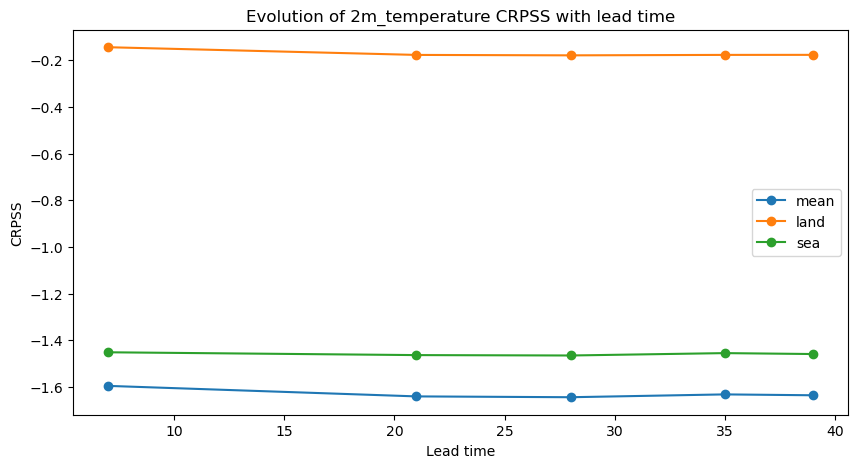

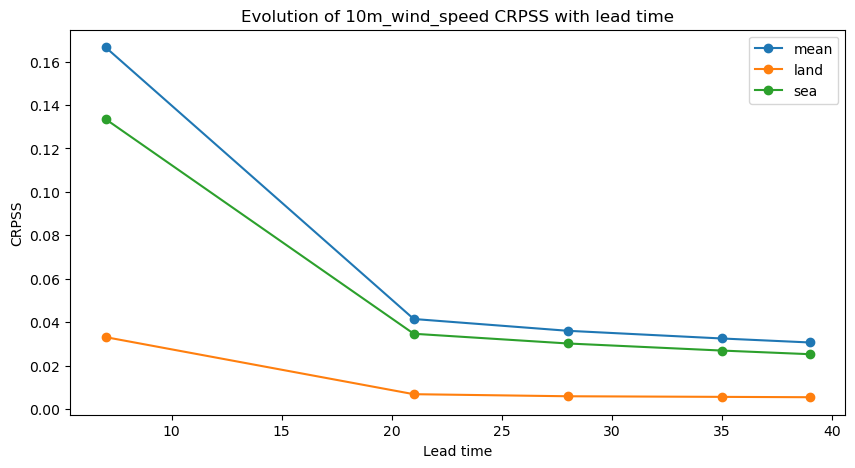

In [16]:
plot_lead_evolution("2m_temperature", y_table_w,['mean', 'land', 'sea'])
plot_lead_evolution("10m_wind_speed", y_table_w,['mean', 'land', 'sea'])

### Raw Model 

In [8]:
month_table_weight(14,"raw", cutoff_mask=0.5)

,month,variable,crps,mean,std,land,sea,90-30N,30S-30N,90-30S
0,1,2m_temperature,0.805206,0.083650,0.605064,-0.063971,0.147621,-0.013434,-0.115078,-0.012320
1,2,2m_temperature,0.846354,0.094806,0.621840,-0.058755,0.153560,0.022416,-0.125423,-0.005947
2,3,2m_temperature,0.812854,0.078072,0.641080,-0.075814,0.153886,-0.028275,-0.137714,-0.000191
3,4,2m_temperature,0.771445,0.053938,0.659362,-0.093803,0.147742,-0.061636,-0.159238,0.003424
4,5,2m_temperature,0.761719,0.053542,0.643114,-0.085743,0.139285,-0.060910,-0.142138,0.000815
5,6,2m_temperature,0.721384,0.038653,0.666680,-0.082064,0.120717,-0.049777,-0.139708,-0.000189
6,7,2m_temperature,0.713024,0.011677,0.710860,-0.102700,0.114377,-0.061952,-0.174215,-0.001785
7,8,2m_temperature,0.700608,0.030430,0.709366,-0.098784,0.129214,-0.058146,-0.168388,-0.001498
8,9,2m_temperature,0.700028,0.027701,0.769091,-0.110192,0.137894,-0.008971,-0.211841,-0.008134
9,10,2m_temperature,0.725297,0.065024,0.684980,-0.077416,0.142440,0.011366,-0.163191,0.005487


In [11]:
raw_y_table = year_table_weight([7,14,21,28,35,39], "raw")
raw_y_table

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,0.935916,-0.141467,0.690239,-0.097438,-0.044029,-0.103204,-0.138015,-0.012575,7
1,2m_temperature,6.5,0.648860,0.175190,0.869713,-0.068377,0.243567,0.040943,-0.164406,0.014951,7
0,10m_wind_speed,6.5,1.019828,-0.218442,0.661806,-0.111039,-0.107403,-0.127521,-0.148070,-0.022865,14
1,2m_temperature,6.5,0.763652,0.059206,0.666904,-0.083681,0.142887,-0.029126,-0.151982,-0.002244,14
0,10m_wind_speed,6.5,1.046328,-0.245454,0.665510,-0.115975,-0.129479,-0.135823,-0.153068,-0.024467,21
1,2m_temperature,6.5,0.806574,0.009030,0.641122,-0.092796,0.101826,-0.053219,-0.156022,-0.006969,21
0,10m_wind_speed,6.5,1.051847,-0.250516,0.664275,-0.116795,-0.133721,-0.137332,-0.154060,-0.024289,28
1,2m_temperature,6.5,0.825732,-0.015642,0.633944,-0.095174,0.079532,-0.064205,-0.155077,-0.007622,28
0,10m_wind_speed,6.5,1.053296,-0.251170,0.662555,-0.116961,-0.134209,-0.137658,-0.154432,-0.023900,35
1,2m_temperature,6.5,0.836501,-0.032049,0.629980,-0.095657,0.063607,-0.070096,-0.153080,-0.007784,35


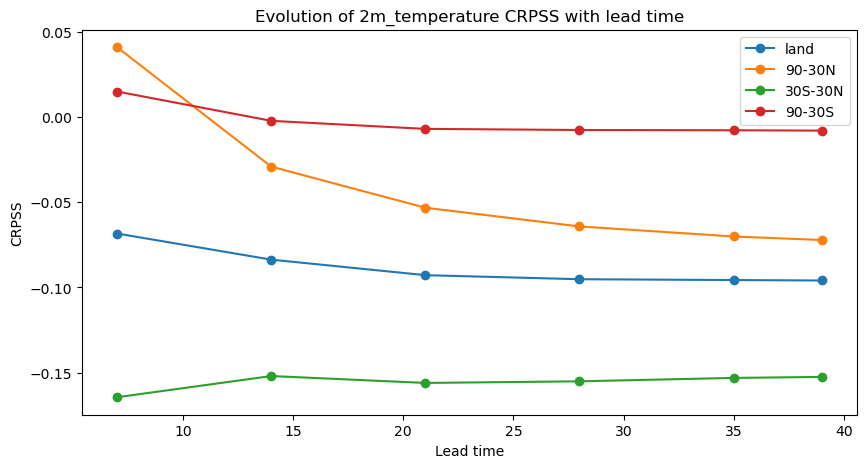

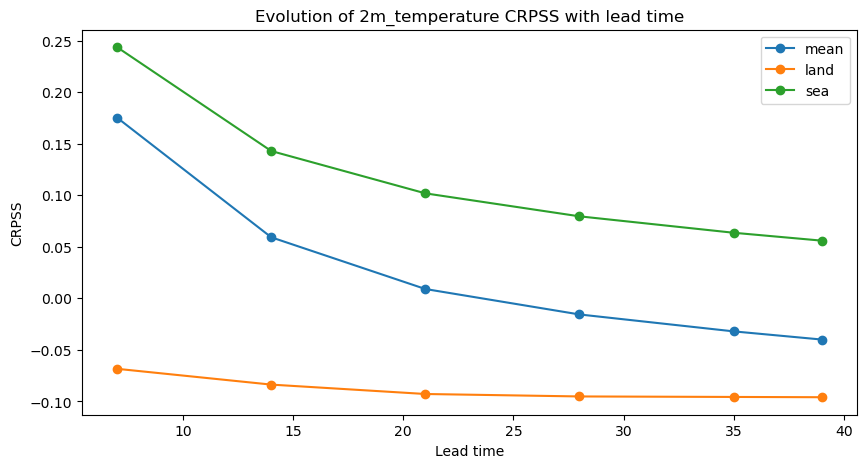

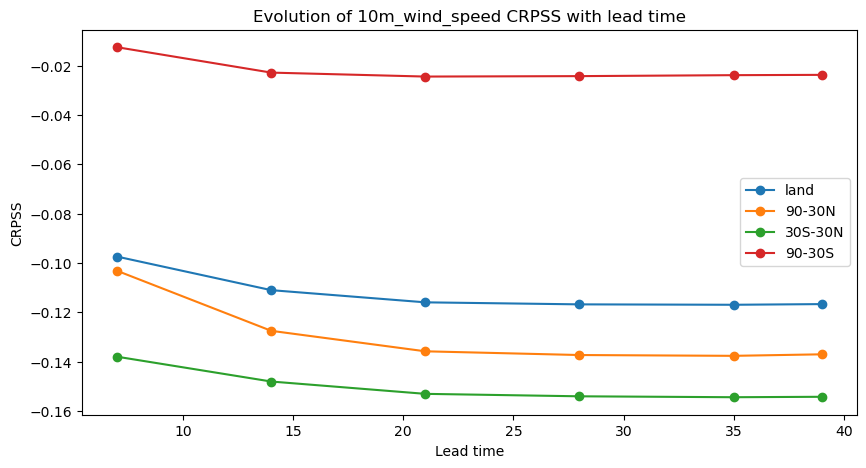

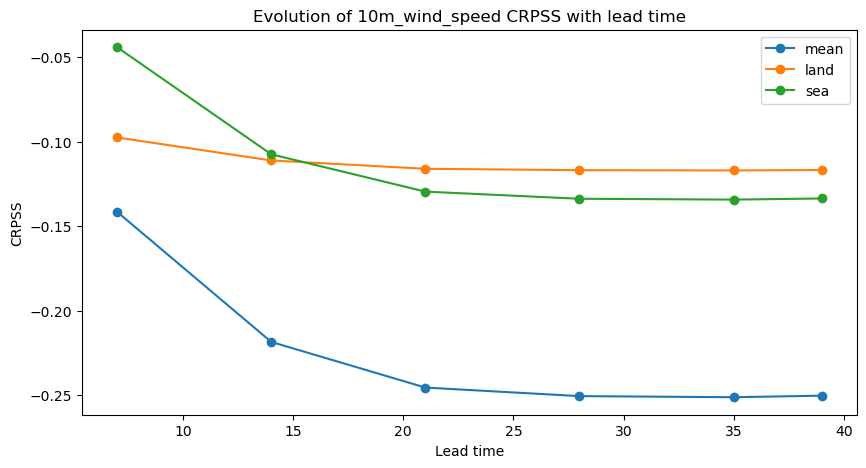

In [7]:
plot_lead_evolution("2m_temperature", raw_y_table,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution("2m_temperature", raw_y_table,['mean', 'land', 'sea'])
plot_lead_evolution("10m_wind_speed", raw_y_table,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution("10m_wind_speed", raw_y_table,['mean', 'land', 'sea'])

In [15]:
def plot_lead_evolution_comparison(var, y_table1, y_table2, metrics):
    plt.figure(figsize=(10, 5))
    colors = ['b', 'g', 'r', 'c', 'm', 'y', 'k']
    for i,metric in enumerate(metrics):
        plt.plot(y_table1[y_table1.variable == var].lead, y_table1[y_table1.variable == var][metric], label=metric, marker='o', linestyle='--', color=colors[i])
        plt.plot(y_table2[y_table2.variable == var].lead, y_table2[y_table2.variable == var][metric], label=metric, marker='o', linestyle='-', color=colors[i])
    plt.xlabel("Lead time")
    plt.ylabel("CRPSS")
    plt.title(f"Evolution of {var} CRPSS with lead time")
    plt.legend()

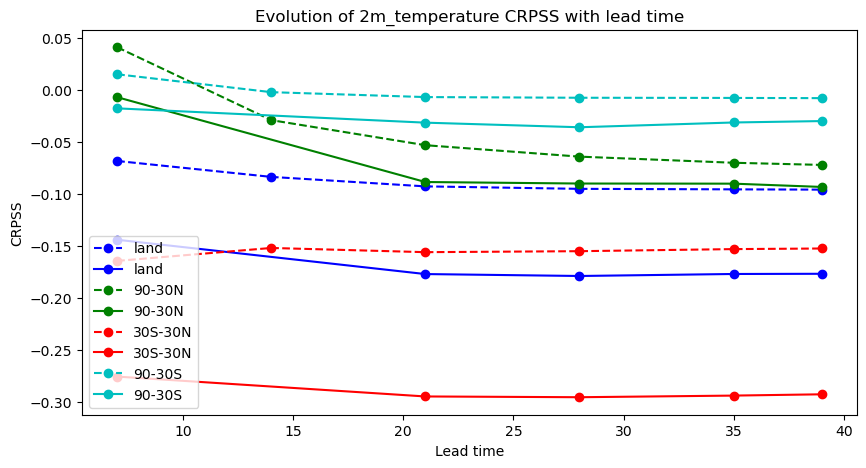

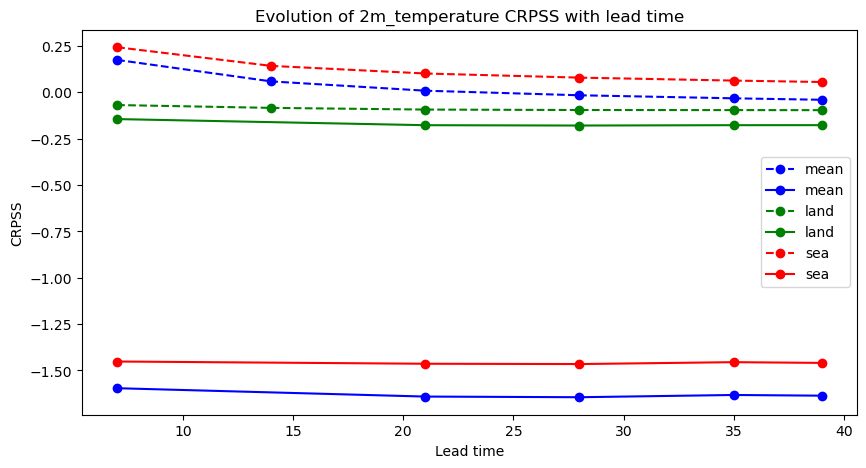

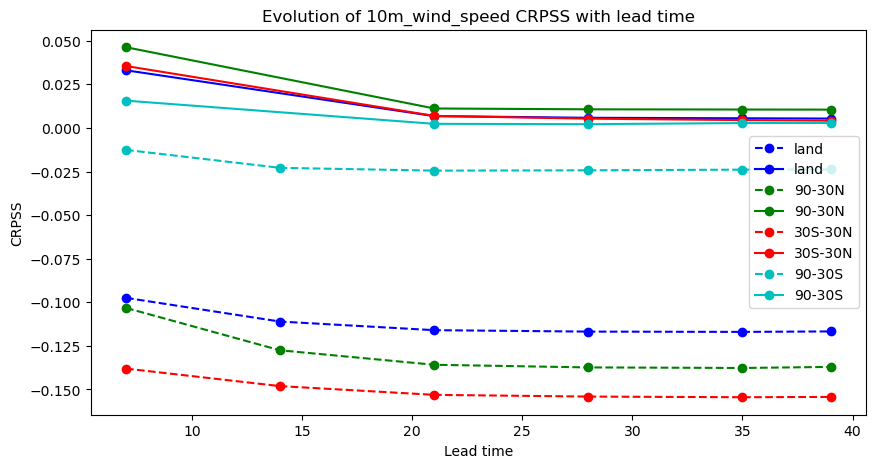

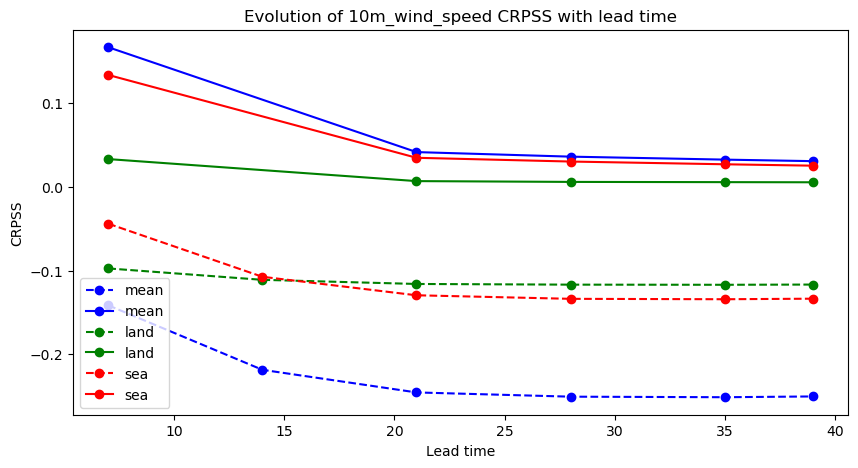

In [16]:
plot_lead_evolution_comparison("2m_temperature", raw_y_table,y_table_w,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution_comparison("2m_temperature", raw_y_table,y_table_w,['mean', 'land', 'sea'])
plot_lead_evolution_comparison("10m_wind_speed", raw_y_table,y_table_w,['land','90-30N', '30S-30N', '90-30S'])
plot_lead_evolution_comparison("10m_wind_speed", raw_y_table,y_table_w,['mean', 'land', 'sea'])

### Comparison climato train, climato obs 

In [3]:
def month_table_weight_naive(lead_time,cutoff_mask=0.5):
    obs_folder = "/home/majanvie/scratch/data/raw/obs"
    base_dir = f"{obs_folder}/climato/mean_train"  
    land_sea_mask = xr.open_dataset(f"{obs_folder}/land_sea_mask.nc").land_sea_mask.values.T # (lat, lon)
    land_sea_mask = land_sea_mask > cutoff_mask

    table = []
    for variable in ["2m_temperature", "10m_wind_speed"]:
        if variable == "2m_temperature":
            name_var = variable[3:]
        else:
            name_var = variable[4:]

        for month in range(1,13):
            # get month data 
            file_path = f"{base_dir}/crps_month{month}_{variable}.nc"
            eval_data = xr.open_dataset(file_path) 

            # cos weights for latitude
            lats = eval_data.latitude
            weights = np.cos(np.deg2rad(lats))

            crps = eval_data[f"crps_{name_var}"].weighted(weights).mean(dim='time')
            crps_clim = eval_data[f"crps_{name_var}_climato"].weighted(weights).mean(dim='time')
            crpss = compute_crpss(crps, crps_clim)

            crpss_land = crpss * land_sea_mask
            crpss_sea = crpss * (1 - land_sea_mask)

            table.append({
                "month": month,
                "variable": variable,
                "crps": crps.weighted(weights).mean().item(),
                "mean": crpss.weighted(weights).mean().item(),
                "std": crpss.weighted(weights).std().item(),
                "land": crpss_land.weighted(weights).mean().item(),
                "sea": crpss_sea.weighted(weights).mean().item(),
                "90-30N": crpss_land.sel(latitude=slice(30, 90)).weighted(weights).mean().item(),  
                "30S-30N": crpss_land.sel(latitude=slice(-30, 30)).weighted(weights).mean().item(), 
                "90-30S": crpss_land.sel(latitude=slice(-90, -30)).weighted(weights).mean().item()
            })

    return pd.DataFrame(table)
    
def year_table_weight_naive(leads):
    table = []
    for lead in leads:
        m_table = month_table_weight_naive(lead)
        year_table = m_table.groupby('variable').mean().reset_index()
        year_table['lead'] = lead
        table.append(year_table)
    return pd.concat(table) 

In [4]:
year_table_weight_naive([28])

,variable,month,crps,mean,std,land,sea,90-30N,30S-30N,90-30S,lead
0,10m_wind_speed,6.5,1.184010,-0.403586,0.731759,-0.185747,-0.217839,-0.288911,-0.203963,-0.051533,28
1,2m_temperature,6.5,2.490381,-2.461240,3.088122,-0.909018,-1.552222,-1.095614,-0.873263,-0.800622,28
